<a href="https://colab.research.google.com/github/tuhinmallick/AI-for-Fashion/blob/main/NHITS_FullTutorial_Substack.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

In [ ]:
%%capture
!pip install neuralforecast
!pip install StatsForecast

In [ ]:
!pip show neuralforecast

Name: neuralforecast
Version: 1.6.4
Summary: Time series forecasting suite using deep learning models
Home-page: https://github.com/Nixtla/neuralforecast/
Author: Nixtla
Author-email: business@nixtla.io
License: Apache Software License 2.0
Location: /usr/local/lib/python3.10/dist-packages
Requires: numba, numpy, optuna, pandas, pytorch-lightning, ray, torch, utilsforecast
Required-by: 


In [ ]:
!pip show torch

Name: torch
Version: 2.1.0+cu121
Summary: Tensors and Dynamic neural networks in Python with strong GPU acceleration
Home-page: https://pytorch.org/
Author: PyTorch Team
Author-email: packages@pytorch.org
License: BSD-3
Location: /usr/local/lib/python3.10/dist-packages
Requires: filelock, fsspec, jinja2, networkx, sympy, triton, typing-extensions
Required-by: fastai, neuralforecast, pytorch-lightning, torchaudio, torchdata, torchmetrics, torchtext, torchvision


In [ ]:
!pip show pytorch-lightning

Name: pytorch-lightning
Version: 2.2.0
Summary: PyTorch Lightning is the lightweight PyTorch wrapper for ML researchers. Scale your models. Write less boilerplate.
Home-page: https://github.com/Lightning-AI/lightning
Author: Lightning AI et al.
Author-email: pytorch@lightning.ai
License: Apache-2.0
Location: /usr/local/lib/python3.10/dist-packages
Requires: fsspec, lightning-utilities, numpy, packaging, PyYAML, torch, torchmetrics, tqdm, typing-extensions
Required-by: neuralforecast


In [ ]:
from neuralforecast.core import NeuralForecast
from neuralforecast.models import NHITS

from neuralforecast.losses.numpy import mae, mse
#https://github.com/Nixtla/neuralforecast/blob/main/neuralforecast/losses/pytorch.py#L494
from neuralforecast.losses.pytorch import MQLoss

from statsforecast import StatsForecast
from statsforecast.models import SeasonalNaive

## Download the dataset

Our project will use the **ElectricityLoadDiagrams20112014**  dataset from UCI.

This dataset contains the power usage (in KWs) of 370 clients/consumers with a 15-minute frequency. The data span 4 years (2011–2014). Each consumer represents a distinct time-series.

Some consumers were created after 2011, so their power usage initially is zero.

In [ ]:
!wget https://archive.ics.uci.edu/ml/machine-learning-databases/00321/LD2011_2014.txt.zip
!unzip LD2011_2014.txt.zip

--2024-02-09 09:43:03--  https://archive.ics.uci.edu/ml/machine-learning-databases/00321/LD2011_2014.txt.zip
Resolving archive.ics.uci.edu (archive.ics.uci.edu)... 128.195.10.252
Connecting to archive.ics.uci.edu (archive.ics.uci.edu)|128.195.10.252|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: unspecified
Saving to: ‘LD2011_2014.txt.zip’

LD2011_2014.txt.zip     [           <=>      ] 249.23M  58.9MB/s    in 4.6s    

2024-02-09 09:43:08 (54.7 MB/s) - ‘LD2011_2014.txt.zip’ saved [261335609]

Archive:  LD2011_2014.txt.zip
  inflating: LD2011_2014.txt         
   creating: __MACOSX/
  inflating: __MACOSX/._LD2011_2014.txt  


## Data Preprocessing

In [ ]:
data = pd.read_csv('LD2011_2014.txt', index_col=0, sep=';', decimal=',')
data.index = pd.to_datetime(data.index)
data.sort_index(inplace=True)
data.head(5)

,MT_001,MT_002,MT_003,MT_004,MT_005,MT_006,MT_007,MT_008,MT_009,MT_010,...,MT_361,MT_362,MT_363,MT_364,MT_365,MT_366,MT_367,MT_368,MT_369,MT_370
2011-01-01 00:15:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2011-01-01 00:30:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2011-01-01 00:45:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2011-01-01 01:00:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2011-01-01 01:15:00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


We do data preprocessing as follows:

* Aggregate our target variable **power_usage** by hour.
* Find the earliest date for every time-series where power is non-zero.
* Create new features : **month**, **day**, **hour** and **day_of_week**.
* Select all days between *2014–01–01* and *2014–09–07.*
* We keep 5 out of 370 time-series (electrical consumer households)

Hence, our dataset has an **hourly** granularity

In [ ]:
data = data.resample('1h').mean().replace(0., np.nan)
earliest_time = data.index.min()
df=data[['MT_002', 'MT_004', 'MT_005', 'MT_006', 'MT_008' ]] # here, we keep 5 consumers out of 370

In [ ]:
df_list = []

for label in df:

    ts = df[label]

    start_date = min(ts.fillna(method='ffill').dropna().index)
    end_date = max(ts.fillna(method='bfill').dropna().index)

    active_range = (ts.index >= start_date) & (ts.index <= end_date)
    ts = ts[active_range].fillna(0.)

    tmp = pd.DataFrame({'power_usage': ts})
    date = tmp.index

    tmp['hours_from_start'] = (date - earliest_time).seconds / 60 / 60 + (date - earliest_time).days * 24
    tmp['hours_from_start'] = tmp['hours_from_start'].astype('int')

    tmp['days_from_start'] = (date - earliest_time).days
    tmp['date'] = date
    tmp['consumer_id'] = label
    tmp['hour'] = date.hour
    tmp['day'] = date.day
    tmp['day_of_week'] = date.dayofweek
    tmp['month'] = date.month

    #stack all time series vertically
    df_list.append(tmp)

time_df = pd.concat(df_list).reset_index(drop=True)

# match results in the original paper
time_df = time_df[(time_df['days_from_start'] >= 1096)
                & (time_df['days_from_start'] < 1346)].copy()

In [ ]:
time_df

,power_usage,hours_from_start,days_from_start,date,consumer_id,hour,day,day_of_week,month
17544,24.004267,26304,1096,2014-01-01 00:00:00,MT_002,0,1,2,1
17545,23.293030,26305,1096,2014-01-01 01:00:00,MT_002,1,1,2,1
17546,24.537696,26306,1096,2014-01-01 02:00:00,MT_002,2,1,2,1
17547,21.870555,26307,1096,2014-01-01 03:00:00,MT_002,3,1,2,1
17548,22.226174,26308,1096,2014-01-01 04:00:00,MT_002,4,1,2,1
...,...,...,...,...,...,...,...,...,...
128759,249.158249,32299,1345,2014-09-07 19:00:00,MT_008,19,7,6,9
128760,303.030303,32300,1345,2014-09-07 20:00:00,MT_008,20,7,6,9
128761,306.397306,32301,1345,2014-09-07 21:00:00,MT_008,21,7,6,9
128762,279.461279,32302,1345,2014-09-07 22:00:00,MT_008,22,7,6,9


The goal is to build a model that:
* Performs day-ahead forecasting (forecast next 24 hours, hence horizon = 24)
* Uses the previous week as a lookback window (hence 24*7 = 168 datapoints)

## Baseline

First, run a **Naive Seasonal** model as a baseline that models a daily seasonality:

In [ ]:
df = time_df.rename(columns={'date': 'ds', 'consumer_id': 'unique_id', 'power_usage': 'y'})
df = df.loc[:, ['ds', 'unique_id', 'y']]
df

,ds,unique_id,y
17544,2014-01-01 00:00:00,MT_002,24.004267
17545,2014-01-01 01:00:00,MT_002,23.293030
17546,2014-01-01 02:00:00,MT_002,24.537696
17547,2014-01-01 03:00:00,MT_002,21.870555
17548,2014-01-01 04:00:00,MT_002,22.226174
...,...,...,...
128759,2014-09-07 19:00:00,MT_008,249.158249
128760,2014-09-07 20:00:00,MT_008,303.030303
128761,2014-09-07 21:00:00,MT_008,306.397306
128762,2014-09-07 22:00:00,MT_008,279.461279


In [ ]:
horizon=24

Y_train_df = df[df.ds<df['ds'].values[-(1*horizon) ]]
Y_test_df = df[df.ds>=df['ds'].values[-(1*horizon)]]

In [ ]:
sf = StatsForecast(
    models=[ SeasonalNaive(season_length=24)],
    freq='H')

sf = sf.fit(df=Y_train_df)

In [ ]:
# add a 90% confidence interval
predictions = sf.predict(h=horizon, level=[90])
predictions

,ds,SeasonalNaive,SeasonalNaive-lo-90,SeasonalNaive-hi-90
unique_id,,,,
MT_002,2014-09-07 00:00:00,33.428165,27.975815,38.880516
MT_002,2014-09-07 01:00:00,28.093884,22.641533,33.546234
MT_002,2014-09-07 02:00:00,26.315790,20.863440,31.768141
MT_002,2014-09-07 03:00:00,26.849218,21.396868,32.301567
MT_002,2014-09-07 04:00:00,26.315790,20.863440,31.768141
...,...,...,...,...
MT_008,2014-09-07 19:00:00,281.144775,232.111420,330.178131
MT_008,2014-09-07 20:00:00,318.181824,269.148468,367.215179
MT_008,2014-09-07 21:00:00,312.289551,263.256195,361.322906


In [ ]:
predictions['y']=Y_test_df['y'].values
predictions_df = predictions.groupby('unique_id').apply(lambda group: pd.Series({
    'MSE': mse(group['y'], group['SeasonalNaive']),
    'MAE': mae(group['y'], group['SeasonalNaive'])
})).reset_index()
predictions_df

,unique_id,MSE,MAE
0,MT_002,3.220898,1.533606
1,MT_004,107.474141,8.553522
2,MT_005,15.429803,3.150407
3,MT_006,962.976091,24.522570
4,MT_008,697.178163,20.938551


In [ ]:
# Calculate MAE and MSE metrics over all time-series
predictions_df['MAE'].mean(), predictions_df['MSE'].mean()

(11.739731077927534, 357.25581937177384)

# NHITS - Univariate Case

### Training the Model

* **Lookback window**: 7 * 24 hours
* **Horizon**:  24 hours
* **Max epochs**: 300
* **EarlyStopping Callback with patence** = 5 epochs
* **Validate loss every 5 epochs**
* **Loss**: Multi-Quantile loss (Probabilistic Forecasting) [check here](https://github.com/Nixtla/neuralforecast/blob/main/neuralforecast/losses/pytorch.py#L494)

In [ ]:
horizon=24

models = [NHITS(h=horizon,
              input_size=7*horizon,
              loss=MQLoss(quantiles=[0.1,0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 0.95]),
              max_steps=300,early_stop_patience_steps=5,
              val_check_steps=5,
              scaler_type = 'robust')]

nf = NeuralForecast(models=models, freq='H')

nf.fit(df=Y_train_df, val_size=24)

INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

### Predictions on the train & validation set (in-sample)

In [ ]:
nf.predict_insample(step_size=horizon)

Predicting: |          | 0/? [00:00<?, ?it/s]

,unique_id,ds,cutoff,NHITS-lo-80.0,NHITS-lo-60.0,NHITS-lo-40.0,NHITS-lo-20.0,NHITS-median,NHITS-hi-20.0,NHITS-hi-40.0,NHITS-hi-60.0,NHITS-hi-80.0,NHITS-hi-90.0,y
0,MT_002,2014-01-01 00:00:00,2013-12-31 23:00:00,-0.166487,-0.045745,-0.068478,-0.131192,-0.029827,0.012133,0.018303,-0.031641,0.134446,0.121066,24.004267
1,MT_002,2014-01-01 01:00:00,2013-12-31 23:00:00,-0.198146,-0.074122,-0.078790,-0.159731,-0.041551,-0.005858,-0.028410,-0.066961,0.081513,0.053668,23.293030
2,MT_002,2014-01-01 02:00:00,2013-12-31 23:00:00,-0.187708,-0.164692,-0.120047,-0.140025,-0.099737,-0.058499,-0.044220,-0.062209,0.020362,-0.021675,24.537695
3,MT_002,2014-01-01 03:00:00,2013-12-31 23:00:00,-0.202595,-0.118888,-0.121907,-0.136408,-0.098826,-0.049569,0.000725,-0.060824,0.047938,-0.033027,21.870554
4,MT_002,2014-01-01 04:00:00,2013-12-31 23:00:00,-0.242240,-0.143463,-0.143950,-0.108022,-0.110462,-0.023864,0.024287,-0.020265,0.039231,0.018186,22.226173
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29875,MT_008,2014-09-06 19:00:00,2014-09-05 23:00:00,255.413834,268.814697,278.117859,281.188965,286.137604,289.098389,296.911102,302.840088,312.353149,320.688751,281.144775
29876,MT_008,2014-09-06 20:00:00,2014-09-05 23:00:00,263.808197,272.276367,282.346222,285.169373,288.772644,296.820374,307.612305,306.188293,316.407715,321.739075,318.181824
29877,MT_008,2014-09-06 21:00:00,2014-09-05 23:00:00,261.966492,270.261047,276.952850,279.939819,282.340332,287.930237,294.191742,301.906647,309.581268,315.101318,312.289551
29878,MT_008,2014-09-06 22:00:00,2014-09-05 23:00:00,241.928101,256.629639,261.781952,265.863068,268.528229,271.797638,276.553009,280.434418,290.868866,296.476807,281.986542


### Evaluate the Model on the Test Set

In [ ]:
predictions = nf.predict()
# these are equivalent for our case:
#predictions = nf.predict(futr_df=Y_test_df)
#predictions = nf.predict(df=Y_train_df)
predictions['y']=Y_test_df['y'].values
predictions_df = predictions.groupby('unique_id').apply(lambda group: pd.Series({
    'MSE': mse(group['y'], group['NHITS-median']),
    'MAE': mae(group['y'], group['NHITS-median'])
})).reset_index()
predictions_df

Predicting: |          | 0/? [00:00<?, ?it/s]

,unique_id,MSE,MAE
0,MT_002,2.722264,1.326210
1,MT_004,108.221771,8.186019
2,MT_005,24.280331,3.563819
3,MT_006,274.046702,13.772288
4,MT_008,512.016045,17.345864


In [ ]:
# Calculate MAE and MSE metrics over all time-series
predictions_df['MAE'].mean(), predictions_df['MSE'].mean()

(8.838839992007449, 184.25742242983034)

**Note**: By default, NeuralForecast evaluates the model on the last **val_size**
 elements of the training set.

In our case, we chose **val_size = horizon =24**, so the validation set will be the last 24 datapoints of our training set. This is fixed in every epoch.

You can also set **val_size** > **horizon** (let's say **val_size** = **horizon +1**). In that cases, validation will happen on 2 val_size windows:  
* First, on the last **val_size**
 elements of the training set (same as before).
* Secondly, on the last **val_size**
 elements of the training set, slided to the left, by one step

 As **val_size** increases compared to **horizon**, validation will happen on more windows, however less data is reserved for training. This process essentially performs cross-validation with step-size=1.

 There is a more friendly command to perform cross-validation which we'll show on a later section



**Note**: By default, NeuralForecast evaluates the model on the last **val_size** elements of the training set.

In our case, we chose **val_size = horizon = 24**, so the validation set will consist of the last 24 data points from our training set. This configuration remains fixed in every epoch.

You can also set **val_size** > **horizon** (let's say **val_size = horizon + 1**). In such cases, validation will occur in two **val_size** windows:

1. First, on the last **val_size** elements of the training set (as mentioned earlier).
2. Secondly, on the last **val_size** elements of the training set, slid to the left by one step.

As **val_size** increases relative to **horizon**, validation will take place in more windows - however, less data is reserved for training. This process essentially performs cross-validation with a step size of 1.

A more user-friendly command for performing cross-validation will be demonstrated in a later section.


In [ ]:
# And a visual example:

# Assume:
# * x are the training time steps
# * y are the time steps used for validation
# - not used

# A) horizon = 2 = val_size
# |-------------------|
# | x x x x x x x y y |


# B) horizon = 2, val_size =3
# |-------------------|
# | x x x x x x x y y |
# | x x x x x x y y - |

#On B) case, we have 2 validation windows.


### Save and Reload the model

In [ ]:
nf.save(path='nhits-max=300-early=5-val-5-scale-v1.2',
        model_index=None,
        overwrite=True,
        save_dataset=True)

In [ ]:
!zip -r nhits-max=300-early=5-val-5-scale-v1.2.zip nhits-max=300-early=5-val-5-scale-v1.2

  adding: nhits-max=300-early=5-val-5-scale-v1.2/ (stored 0%)
  adding: nhits-max=300-early=5-val-5-scale-v1.2/configuration.pkl (deflated 69%)
  adding: nhits-max=300-early=5-val-5-scale-v1.2/dataset.pkl (deflated 77%)
  adding: nhits-max=300-early=5-val-5-scale-v1.2/nhits_0.ckpt (deflated 8%)


In [ ]:
# first run !rm -r nhits-max=300-early=5-val-5-scale-v1.2
!unzip nhits-max=300-early=5-val-5-scale-v1.2.zip

Archive:  nhits-max=300-early=5-val-5-scale-v1.2.zip
   creating: nhits-max=300-early=5-val-5-scale-v1.2/
  inflating: nhits-max=300-early=5-val-5-scale-v1.2/configuration.pkl  
  inflating: nhits-max=300-early=5-val-5-scale-v1.2/dataset.pkl  
  inflating: nhits-max=300-early=5-val-5-scale-v1.2/nhits_0.ckpt  


In [ ]:
nf2 = NeuralForecast.load(path='nhits-max=300-early=5-val-5-scale-v1.2')

INFO:lightning_fabric.utilities.seed:Seed set to 1


In [ ]:
# verify that the loaded model matches the MAE and MSE scores of the one we saved previously
predictions = nf2.predict(futr_df=Y_test_df)
predictions['y']=Y_test_df['y'].values
predictions_df = predictions.groupby('unique_id').apply(lambda group: pd.Series({
    'MSE': mse(group['y'], group['NHITS-median']),
    'MAE': mae(group['y'], group['NHITS-median'])
})).reset_index()
predictions_df['MAE'].mean(), predictions_df['MSE'].mean()

Predicting: |          | 0/? [00:00<?, ?it/s]

(8.838839992007449, 184.25742242983034)

### Plot Predictions on the Test Set

In [ ]:
predictions = predictions.set_index(['ds'], append=True)
predictions

NHITS-lo-80.0  NHITS-lo-60.0  NHITS-lo-40.0  \
unique_id ds                                                                 
MT_002    2014-09-07 00:00:00      27.793531      28.354382      28.955557   
          2014-09-07 01:00:00      25.345306      25.459946      26.192364   
          2014-09-07 02:00:00      22.932125      23.643269      24.072357   
          2014-09-07 03:00:00      22.005714      21.920181      23.046976   
          2014-09-07 04:00:00      22.177057      22.842972      23.128918   
...                                      ...            ...            ...   
MT_008    2014-09-07 19:00:00     248.985443     260.969849     268.272949   
          2014-09-07 20:00:00     264.604980     270.512299     281.302490   
          2014-09-07 21:00:00     271.460327     276.610596     281.836365   
          2014-09-07 22:00:00     251.278687     264.574097     268.557068   
          2014-09-07 23:00:00     237.167221     246.895508     251.735489   

                               NHITS-lo-20.0  NHITS-median  NHITS-hi-20.0  \
unique_id ds                                                                
MT_002    2014-09-07 00:00:00      29.409151     29.688332      30.142763   
          2014-09-07 01:00:00      26.223339     26.579239      26.680176   
          2014-09-07 02:00:00      24.041458     24.445889      24.779713   
          2014-09-07 03:00:00      22.994202     23.390146      23.104378   
          2014-09-07 04:00:00      23.772301     23.809071      23.844410   
...                                      ...           ...            ...   
MT_008    2014-09-07 19:00:00     273.247772    279.034668     281.268372   
          2014-09-07 20:00:00     285.468140    290.744110     298.335938   
          2014-09-07 21:00:00     287.271362    291.123962     295.710449   
          2014-09-07 22:00:00     275.613647    277.438477     281.651154   
          2014-09-07 23:00:00     252.687698    262.216766     260.473724   

                               NHITS-hi-40.0  NHITS-hi-60.0  NHITS-hi-80.0  \
unique_id ds                                                                 
MT_002    2014-09-07 00:00:00      29.814411      30.449966      31.308241   
          2014-09-07 01:00:00      26.977852      28.073441      28.066734   
          2014-09-07 02:00:00      24.358477      25.248909      25.214825   
          2014-09-07 03:00:00      23.491100      24.405121      24.169991   
          2014-09-07 04:00:00      23.959454      24.338423      24.787354   
...                                      ...            ...            ...   
MT_008    2014-09-07 19:00:00     289.258179     294.902344     302.893463   
          2014-09-07 20:00:00     307.597168     305.991058     317.160889   
          2014-09-07 21:00:00     302.621552     309.382111     318.327576   
          2014-09-07 22:00:00     287.258179     288.090668     298.704285   
          2014-09-07 23:00:00     268.074677     271.388184     272.600830   

                               NHITS-hi-90.0           y  
unique_id ds                                              
MT_002    2014-09-07 00:00:00      31.521229   31.116643  
          2014-09-07 01:00:00      28.598442   25.960171  
          2014-09-07 02:00:00      26.260553   24.715505  
          2014-09-07 03:00:00      24.790398   24.715505  
          2014-09-07 04:00:00      26.500450   24.537696  
...                                      ...         ...  
MT_008    2014-09-07 19:00:00     312.409760  249.158249  
          2014-09-07 20:00:00     323.225464  303.030303  
          2014-09-07 21:00:00     324.751648  306.397306  
          2014-09-07 22:00:00     307.612579  279.461279  
          2014-09-07 23:00:00     279.579224  250.841751  

[120 rows x 11 columns]

In [ ]:
def plot_timeseries(Y_train_df, predictions, item_ids_to_plot, out_of_sample=None):
    colors = ['#FF6347', '#4169E1', '#3DC24C', '#FF69B4', '#8B008B']

    plt.figure(figsize=(15, 3 * len(item_ids_to_plot)))

    for i, item_id in enumerate(item_ids_to_plot):
        plt.subplot(len(item_ids_to_plot), 1, i + 1)

        y_past = Y_train_df.set_index(['unique_id', 'ds']).loc[item_id]['y']
        y_pred = predictions.loc[item_id]
        y_test = predictions.loc[item_id]['y']

        plt.plot(y_past[-400:], label="Past Time Series", color=colors[0], linestyle='-')
        plt.plot(y_pred['NHITS-median'], label="Forecast", color=colors[1], linestyle='-')

        # Check if out_of_sample is provided and not empty
        if out_of_sample is not None and not out_of_sample.empty:
            y_out_of_sample = out_of_sample.loc[item_id]
            plt.plot(y_out_of_sample['NHITS-median'], label="Out-of-Sample", color=colors[4], linestyle='-')
            plt.fill_between(y_out_of_sample.index, y_out_of_sample["NHITS-lo-80.0"], y_out_of_sample["NHITS-hi-80.0"], color=colors[4], alpha=0.1, label="10%-90% OOS Confidence Interval")

        plt.plot(y_test, label="Observed", color=colors[2], linestyle='--')
        plt.fill_between(y_pred.index, y_pred["NHITS-lo-80.0"], y_pred["NHITS-hi-80.0"], color=colors[1], alpha=0.1, label="10%-90% Test Confidence Interval")

        plt.legend()
        plt.xlabel("Time")
        plt.ylabel("Value")
        plt.title(f"Predictions for Item {item_id}")
        plt.grid(True, linestyle='--', alpha=0.6)

    plt.tight_layout()
    plt.show()

* NHITS-lo-80.0 : the 80% confidence interval lower bound
* NHITS-hi-80.0 : the 80% confidence interval upper bound   

Hence, we have an 80% confidence interval (10% on each side)

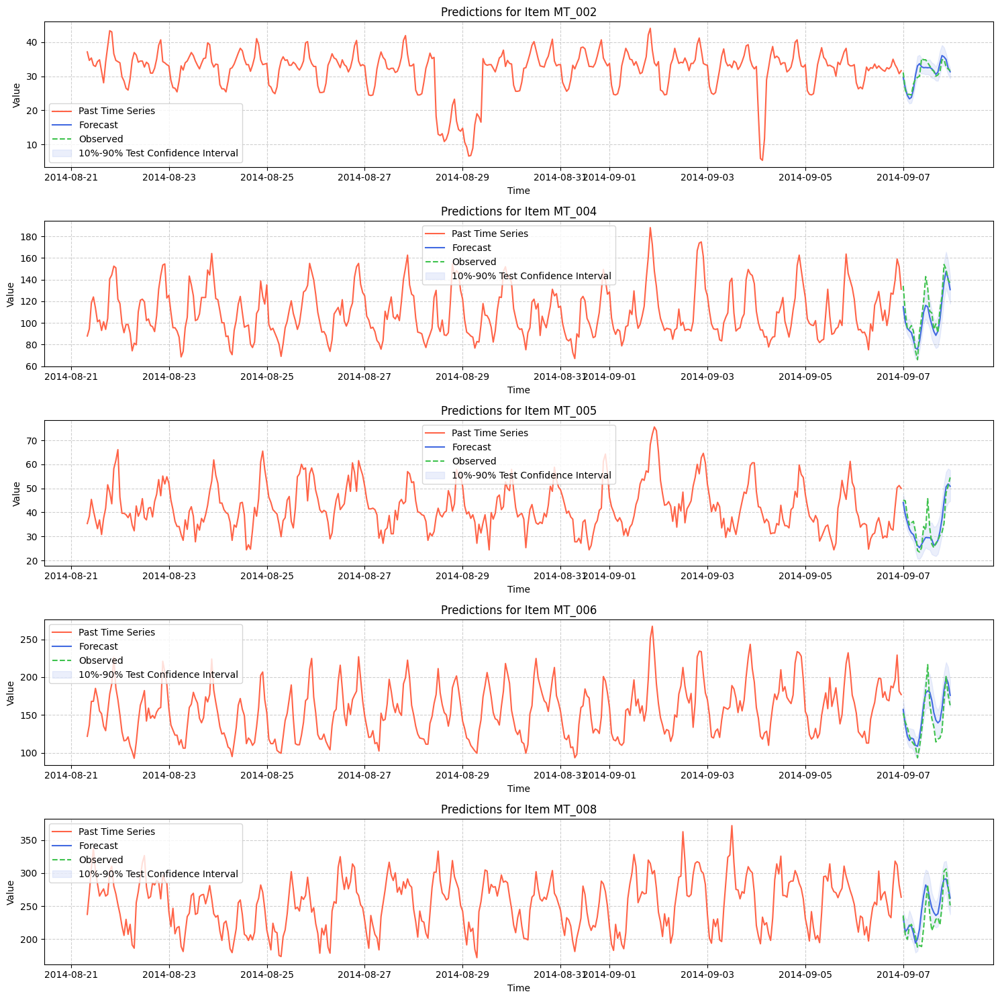

In [ ]:
plot_timeseries(Y_train_df, predictions,item_ids_to_plot=['MT_002', 'MT_004', 'MT_005', 'MT_006', 'MT_008' ], out_of_sample=None)

### Out-of-Sample Forecasting

In [ ]:
# Get last 6 days from train dataset + the 1 day from test dataset
# Hence 7 days in total, equal to our model's input size
last_7_df = pd.concat([Y_train_df.groupby('unique_id').tail(6*24), Y_test_df])
last_7_df

,ds,unique_id,y
23376,2014-09-01 00:00:00,MT_002,33.783784
23377,2014-09-01 01:00:00,MT_002,27.382646
23378,2014-09-01 02:00:00,MT_002,24.715505
23379,2014-09-01 03:00:00,MT_002,24.537696
23380,2014-09-01 04:00:00,MT_002,24.893314
...,...,...,...
128759,2014-09-07 19:00:00,MT_008,249.158249
128760,2014-09-07 20:00:00,MT_008,303.030303
128761,2014-09-07 21:00:00,MT_008,306.397306
128762,2014-09-07 22:00:00,MT_008,279.461279


In [ ]:
840/5/24

7.0

In [ ]:
out_of_sample = nf.predict(df=last_7_df)
out_of_sample = out_of_sample.set_index(['ds'], append=True)
out_of_sample

Predicting: |          | 0/? [00:00<?, ?it/s]

NHITS-lo-80.0  NHITS-lo-60.0  NHITS-lo-40.0  \
unique_id ds                                                                 
MT_002    2014-09-08 00:00:00      27.412804      28.234425      28.892282   
          2014-09-08 01:00:00      24.964142      25.294338      25.911665   
          2014-09-08 02:00:00      22.662464      23.395899      23.726559   
          2014-09-08 03:00:00      21.255505      21.236435      22.251642   
          2014-09-08 04:00:00      21.190889      21.975660      22.057060   
...                                      ...            ...            ...   
MT_008    2014-09-08 19:00:00     255.062561     269.410461     274.411041   
          2014-09-08 20:00:00     271.718201     278.163086     287.004486   
          2014-09-08 21:00:00     274.542084     282.812286     287.381073   
          2014-09-08 22:00:00     251.515900     265.929840     270.358612   
          2014-09-08 23:00:00     232.245132     243.957504     249.009293   

                               NHITS-lo-20.0  NHITS-median  NHITS-hi-20.0  \
unique_id ds                                                                
MT_002    2014-09-08 00:00:00      29.362961     29.781908      30.073458   
          2014-09-08 01:00:00      25.970547     26.393354      26.502724   
          2014-09-08 02:00:00      23.647270     24.081194      24.662186   
          2014-09-08 03:00:00      22.309059     22.725550      22.650019   
          2014-09-08 04:00:00      22.876038     22.815044      23.081062   
...                                      ...           ...            ...   
MT_008    2014-09-08 19:00:00     281.533936    290.380859     288.988068   
          2014-09-08 20:00:00     291.092712    301.674622     303.071167   
          2014-09-08 21:00:00     293.134033    300.782532     302.633820   
          2014-09-08 22:00:00     277.095245    282.553650     287.876434   
          2014-09-08 23:00:00     250.748032    261.339661     258.439484   

                               NHITS-hi-40.0  NHITS-hi-60.0  NHITS-hi-80.0  \
unique_id ds                                                                 
MT_002    2014-09-08 00:00:00      30.080532      30.794588      31.470633   
          2014-09-08 01:00:00      26.976765      28.380575      27.994070   
          2014-09-08 02:00:00      24.133385      25.327568      24.949453   
          2014-09-08 03:00:00      23.011927      23.836994      23.638767   
          2014-09-08 04:00:00      23.129807      23.419867      23.861120   
...                                      ...            ...            ...   
MT_008    2014-09-08 19:00:00     295.842712     307.476959     317.418060   
          2014-09-08 20:00:00     311.879028     317.246155     325.515015   
          2014-09-08 21:00:00     308.934692     320.100464     325.429077   
          2014-09-08 22:00:00     289.795654     295.235474     302.255157   
          2014-09-08 23:00:00     266.886078     272.130646     273.828979   

                               NHITS-hi-90.0  
unique_id ds                                  
MT_002    2014-09-08 00:00:00      31.813099  
          2014-09-08 01:00:00      28.686003  
          2014-09-08 02:00:00      26.125305  
          2014-09-08 03:00:00      24.148327  
          2014-09-08 04:00:00      25.597141  
...                                      ...  
MT_008    2014-09-08 19:00:00     325.280121  
          2014-09-08 20:00:00     333.280365  
          2014-09-08 21:00:00     329.467346  
          2014-09-08 22:00:00     308.596375  
          2014-09-08 23:00:00     277.859650  

[120 rows x 10 columns]

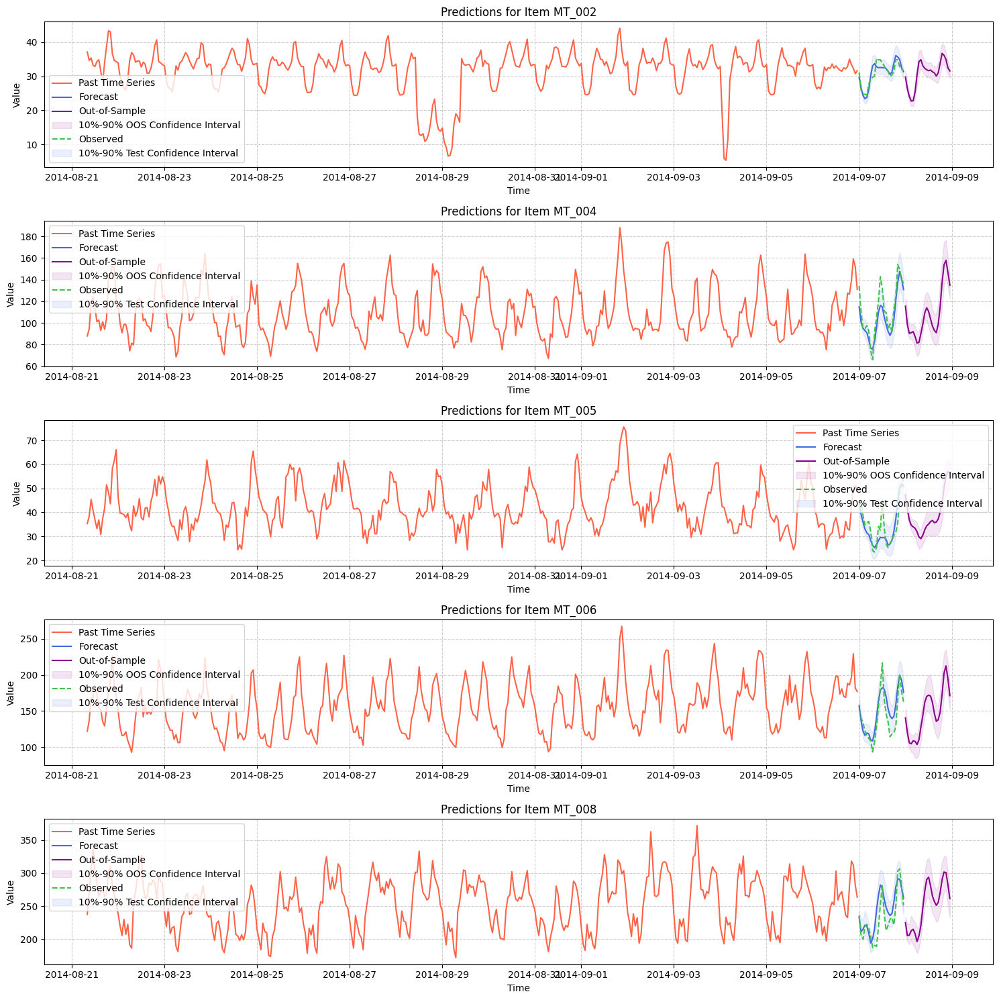

In [ ]:
plot_timeseries(Y_train_df, predictions,item_ids_to_plot=['MT_002', 'MT_004', 'MT_005', 'MT_006', 'MT_008' ], out_of_sample=out_of_sample)

# Multivariate Forecasting (Covariates)

### Prepare data

In [ ]:
horizon=24

df = time_df.rename(columns={'date': 'ds', 'consumer_id': 'unique_id', 'power_usage': 'y'})
df = df.loc[:, ['ds', 'unique_id', 'y',"hours_from_start","day","day_of_week", "month", 'hour']]
df

,ds,unique_id,y,hours_from_start,day,day_of_week,month,hour
17544,2014-01-01 00:00:00,MT_002,24.004267,26304,1,2,1,0
17545,2014-01-01 01:00:00,MT_002,23.293030,26305,1,2,1,1
17546,2014-01-01 02:00:00,MT_002,24.537696,26306,1,2,1,2
17547,2014-01-01 03:00:00,MT_002,21.870555,26307,1,2,1,3
17548,2014-01-01 04:00:00,MT_002,22.226174,26308,1,2,1,4
...,...,...,...,...,...,...,...,...
128759,2014-09-07 19:00:00,MT_008,249.158249,32299,7,6,9,19
128760,2014-09-07 20:00:00,MT_008,303.030303,32300,7,6,9,20
128761,2014-09-07 21:00:00,MT_008,306.397306,32301,7,6,9,21
128762,2014-09-07 22:00:00,MT_008,279.461279,32302,7,6,9,22


In [ ]:
Y_train_df = df[df.ds<df['ds'].values[-(1*horizon) ]]
Y_test_df = df[df.ds>=df['ds'].values[-(1*horizon)]]

### Model Training

In [ ]:
horizon=24

models = [NHITS(h=horizon,
              input_size=7*horizon,
              loss=MQLoss(quantiles=[0.1,0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 0.95]),
              futr_exog_list=["hours_from_start","day","day_of_week", "month", 'hour'],
              max_steps=300,early_stop_patience_steps=10,
              val_check_steps=5,
              scaler_type = 'robust')  ]

nf = NeuralForecast(models=models, freq='H')

nf.fit(df=Y_train_df, val_size=24)

INFO:lightning_fabric.utilities.seed:Seed set to 1


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

### Evaluate the Model

In [ ]:
predictions = nf.predict(futr_df=Y_test_df)
predictions['y']=Y_test_df['y'].values
predictions_df = predictions.groupby('unique_id').apply(lambda group: pd.Series({
    'MSE': mse(group['y'], group['NHITS-median']),
    'MAE': mae(group['y'], group['NHITS-median'])
})).reset_index()
predictions_df

Predicting: |          | 0/? [00:00<?, ?it/s]

,unique_id,MSE,MAE
0,MT_002,2.266202,1.245914
1,MT_004,170.366830,10.589228
2,MT_005,14.989979,2.661790
3,MT_006,172.390529,10.058495
4,MT_008,440.649479,16.778226


In [ ]:
predictions_df['MAE'].mean(), predictions_df['MSE'].mean()

(8.266730553062601, 160.13260395961407)

### Load and Save Model

In [ ]:
nf.save(path='nhits-max=300-early=5-val-5-scale-v2.1',
        model_index=None,
        overwrite=True,
        save_dataset=True)

In [ ]:
!zip -r nhits-max=300-early=5-val-5-scale-v2.1.zip nhits-max=300-early=5-val-5-scale-v2.1

  adding: nhits-max=300-early=5-val-5-scale-v2.1/ (stored 0%)
  adding: nhits-max=300-early=5-val-5-scale-v2.1/dataset.pkl (deflated 92%)
  adding: nhits-max=300-early=5-val-5-scale-v2.1/nhits_0.ckpt (deflated 8%)
  adding: nhits-max=300-early=5-val-5-scale-v2.1/configuration.pkl (deflated 69%)


In [ ]:
!unzip nhits-max=300-early=5-val-5-scale-v2.1.zip

Archive:  nhits-max=300-early=5-val-5-scale-v2.1.zip
   creating: nhits-max=300-early=5-val-5-scale-v2.1/
  inflating: nhits-max=300-early=5-val-5-scale-v2.1/nhits_0.ckpt  
  inflating: nhits-max=300-early=5-val-5-scale-v2.1/dataset.pkl  
  inflating: nhits-max=300-early=5-val-5-scale-v2.1/configuration.pkl  


In [ ]:
nf2 = NeuralForecast.load(path='nhits-max=300-early=5-val-5-scale-v2.1')

INFO:lightning_fabric.utilities.seed:Seed set to 1


In [ ]:
# verify if the loaded model matches the MAE and MSE scores of the one we saved previously
predictions = nf2.predict(futr_df=Y_test_df)
predictions['y']=Y_test_df['y'].values
predictions_df = predictions.groupby('unique_id').apply(lambda group: pd.Series({
    'MSE': mse(group['y'], group['NHITS-median']),
    'MAE': mae(group['y'], group['NHITS-median'])
})).reset_index()
predictions_df['MAE'].mean(), predictions_df['MSE'].mean()

Predicting: |          | 0/? [00:00<?, ?it/s]

(8.266730553062601, 160.13260395961407)

### Plot Predictions

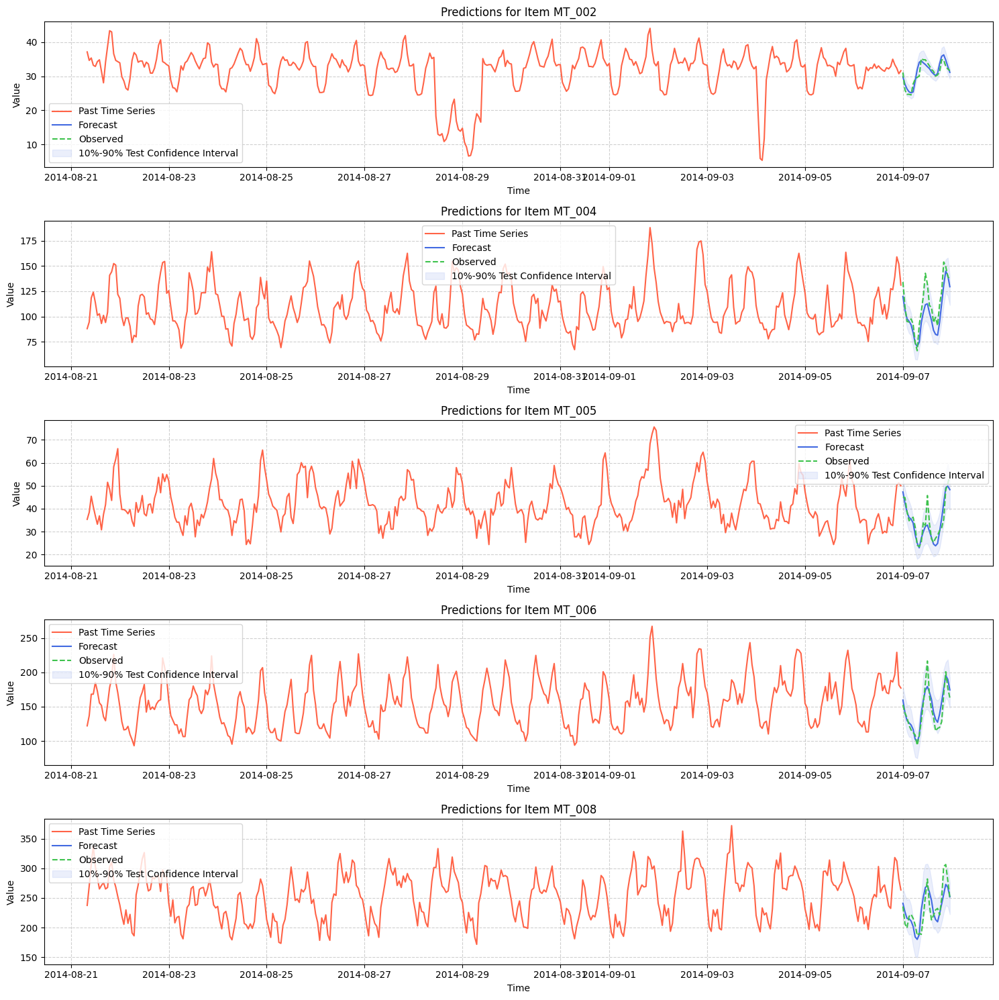

In [ ]:
predictions = predictions.set_index(['ds'], append=True)
plot_timeseries(Y_train_df, predictions,item_ids_to_plot=['MT_002', 'MT_004', 'MT_005', 'MT_006', 'MT_008' ], out_of_sample=None)

# Hyperparameter Tuning


* This section performs hyperparameter tuning using Ray.
* We use the HyperOptSearch algorithm for navigating the hyperaparameters' space

In [ ]:
horizon = 24

In [ ]:
from neuralforecast.auto import AutoNHITS
from ray import tune

There are two options here:

1. We can either define our own hyperparameter configuration.
2. Or use the **AutoNHITS.default_config**, which uses a suggested search space that follows the paper’s hyperparameters and was created by the paper's authors.
We go with the second option, but we'll first make some modifications:

In [ ]:
AutoNHITS.default_config

{'input_size_multiplier': [1, 2, 3, 4, 5],
 'h': None,
 'n_pool_kernel_size': <ray.tune.search.sample.Categorical at 0x7a22d9f79360>,
 'n_freq_downsample': <ray.tune.search.sample.Categorical at 0x7a22d9f79420>,
 'learning_rate': <ray.tune.search.sample.Float at 0x7a22d9f79480>,
 'scaler_type': <ray.tune.search.sample.Categorical at 0x7a22d9f79540>,
 'max_steps': <ray.tune.search.sample.Float at 0x7a22d9f794e0>,
 'batch_size': <ray.tune.search.sample.Categorical at 0x7a22d9f796c0>,
 'windows_batch_size': <ray.tune.search.sample.Categorical at 0x7a22d9f79750>,
 'loss': None,
 'random_seed': <ray.tune.search.sample.Integer at 0x7a22d9f797e0>}

In [ ]:
autohits_conf = AutoNHITS.default_config.copy()
autohits_conf['input_size'] = 7*horizon
autohits_conf.pop('loss', None)
autohits_conf.pop('h', None)
autohits_conf.pop('input_size_multiplier', None)
autohits_conf

{'n_pool_kernel_size': <ray.tune.search.sample.Categorical at 0x7a22d9f79360>,
 'n_freq_downsample': <ray.tune.search.sample.Categorical at 0x7a22d9f79420>,
 'learning_rate': <ray.tune.search.sample.Float at 0x7a22d9f79480>,
 'scaler_type': <ray.tune.search.sample.Categorical at 0x7a22d9f79540>,
 'max_steps': <ray.tune.search.sample.Float at 0x7a22d9f794e0>,
 'batch_size': <ray.tune.search.sample.Categorical at 0x7a22d9f796c0>,
 'windows_batch_size': <ray.tune.search.sample.Categorical at 0x7a22d9f79750>,
 'random_seed': <ray.tune.search.sample.Integer at 0x7a22d9f797e0>,
 'input_size': 168}

In [ ]:
# # if you want to define your own hyperparameter space, you can do so as follows
# # the logic stays the same. Below is a sample configuration:

# nhits_config = {
#        "max_steps": 100,                                                         # Number of SGD steps
#        "input_size": 168,                                                        # Size of input window
#        "learning_rate": tune.loguniform(1e-4, 1e-1),                             # Initial Learning rate
#        "n_pool_kernel_size": tune.choice([[2, 2, 2], [16, 8, 1]]),               # MaxPool's Kernelsize
#        "n_freq_downsample": tune.choice([[168, 24, 1], [24, 12, 1], [1, 1, 1]]), # Interpolation expressivity ratios
#     }

### Best Nhits Model

In [ ]:
df = time_df.rename(columns={'date': 'ds', 'consumer_id': 'unique_id', 'power_usage': 'y'})
df = df.loc[:, ['ds', 'unique_id', 'y']]

Y_train_df = df[df.ds<df['ds'].values[-(1*horizon) ]]
Y_test_df = df[df.ds>=df['ds'].values[-(1*horizon)]]

In [ ]:
from ray.tune.search.hyperopt import HyperOptSearch

In [ ]:
#num_samples = number of experiments the ray tuner will try
models = [AutoNHITS(h=horizon,
              loss=MQLoss(quantiles=[0.1,0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 0.95]),
              config=autohits_conf,
              num_samples=120,
              search_alg=HyperOptSearch()      )]

nf = NeuralForecast(models=models, freq='H')

nf.fit(df=Y_train_df, val_size=24)

2024-01-20 21:28:00,618	INFO tune.py:592 -- [output] This will use the new output engine with verbosity 0. To disable the new output and use the legacy output engine, set the environment variable RAY_AIR_NEW_OUTPUT=0. For more information, please see https://github.com/ray-project/ray/issues/36949


+--------------------------------------------------------------------+
| Configuration for experiment     _train_tune_2024-01-20_21-28-00   |
+--------------------------------------------------------------------+
| Search algorithm                 SearchGenerator                   |
| Scheduler                        FIFOScheduler                     |
| Number of trials                 120                               |
+--------------------------------------------------------------------+

View detailed results here: /root/ray_results/_train_tune_2024-01-20_21-28-00
To visualize your results with TensorBoard, run: `tensorboard --logdir /root/ray_results/_train_tune_2024-01-20_21-28-00`


(_train_tune pid=21607) Seed set to 3
(_train_tune pid=21607) 2024-01-20 21:28:09.909821: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
(_train_tune pid=21607) 2024-01-20 21:28:09.909873: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
(_train_tune pid=21607) 2024-01-20 21:28:09.911174: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
(_train_tune pid=21607) 2024-01-20 21:28:11.215642: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 90.77it/s, v_num=0, train_loss_step=0.578, train_loss_epoch=0.461]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 86.85it/s, v_num=0, train_loss_step=0.324, train_loss_epoch=0.346, valid_loss=7.670]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]
(_train_tune pid=21607) 
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 89.70it/s, v_num=0, train_loss_step=0.303, train_loss_epoch=0.319, valid_loss=5.930]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]
(_train_tune pid=21607) 
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 72.45it/s, v_num=0, train_loss_step=0.306, train_loss_epoch=0.301, valid_loss=5.210]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]
(_train_tune pid=21607) 
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 6

2024-01-20 21:28:27,782	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (40, 20, 1), 'n_pool_kernel_size': (1, 1, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 999: 100%|██████████| 1/1 [00:00<00:00, 88.70it/s, v_num=0, train_loss_step=0.281, train_loss_epoch=0.297, valid_loss=4.910]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 999: 100%|██████████| 1/1 [00:00<00:00, 33.91it/s, v_num=0, train_loss_step=0.281, train_loss_epoch=0.281, valid_loss=4.880]


(_train_tune pid=21607) Seed set to 17


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 79.05it/s, v_num=0, train_loss_step=5.730, train_loss_epoch=5.330]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]
(_train_tune pid=21607) 
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 92.44it/s, v_num=0, train_loss_step=4.570, train_loss_epoch=5.240, valid_loss=3.830]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 92.55it/s, v_num=0, train_loss_step=4.190, train_loss_epoch=4.140, valid_loss=3.530]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 52.02it/s, v_num=0, train_loss_step=4.090, train_loss_epoch=3.990, valid_loss=2.920]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 72.43it/s, v_num=0, train_loss_step=3.800, train_loss_epoch=3.920, valid_loss=2.880]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:   0%|          | 0/1 

2024-01-20 21:28:40,777	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (1, 1, 1), 'n_pool_kernel_size': (2, 2, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 899: 100%|██████████| 1/1 [00:00<00:00, 89.28it/s, v_num=0, train_loss_step=3.270, train_loss_epoch=4.010, valid_loss=2.740]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 899: 100%|██████████| 1/1 [00:00<00:00, 36.95it/s, v_num=0, train_loss_step=3.270, train_loss_epoch=3.270, valid_loss=2.740]


(_train_tune pid=21607) Seed set to 6


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 86.10it/s, v_num=0, train_loss_step=5.370, train_loss_epoch=4.620]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]
(_train_tune pid=21607) 
Validation DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 179.80it/s]
(_train_tune pid=21607) 
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 81.44it/s, v_num=0, train_loss_step=4.590, train_loss_epoch=4.170, valid_loss=3.510]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 56.77it/s, v_num=0, train_loss_step=3.990, train_loss_epoch=3.920, valid_loss=3.090]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 60.65it/s, v_num=0, train_loss_step=3.830, train_loss_epoch=4.260, valid_loss=3.000]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 69.02it/s, v_num=0, train_loss_step=3.620, train_loss_epoch=4.100, valid_loss=3.

2024-01-20 21:28:58,570	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (180, 60, 1), 'n_pool_kernel_size': (16, 8, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 1199: 100%|██████████| 1/1 [00:00<00:00, 61.13it/s, v_num=0, train_loss_step=3.480, train_loss_epoch=3.370, valid_loss=2.750]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 1199: 100%|██████████| 1/1 [00:00<00:00, 29.12it/s, v_num=0, train_loss_step=3.480, train_loss_epoch=3.480, valid_loss=2.810]


(_train_tune pid=21607) Seed set to 16


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 31.52it/s, v_num=0, train_loss_step=4.490, train_loss_epoch=4.660]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 39.53it/s, v_num=0, train_loss_step=4.120, train_loss_epoch=4.130, valid_loss=3.360]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 39.98it/s, v_num=0, train_loss_step=3.890, train_loss_epoch=3.950, valid_loss=2.690]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 39.60it/s, v_num=0, train_loss_step=3.710, train_loss_epoch=3.820, valid_loss=2.610]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 496:   0%|          | 0/1 [00:00<?, ?it/s, v_num=0, train_loss_step=3.770, train_loss_epoch=3.770, valid_loss=2.680]


2024-01-20 21:29:12,898	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (40, 20, 1), 'n_pool_kernel_size': (2, 2, 2), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 38.26it/s, v_num=0, train_loss_step=3.730, train_loss_epoch=3.840, valid_loss=2.680]
(_train_tune pid=21607) 
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 20.74it/s, v_num=0, train_loss_step=3.730, train_loss_epoch=3.730, valid_loss=2.650]


(_train_tune pid=21607) Seed set to 11


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 90.82it/s, v_num=0, train_loss_step=0.276, train_loss_epoch=0.232]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]
(_train_tune pid=21607) 
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 52.89it/s, v_num=0, train_loss_step=0.212, train_loss_epoch=0.234, valid_loss=2.870]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 67.74it/s, v_num=0, train_loss_step=0.203, train_loss_epoch=0.206, valid_loss=2.750]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 82.93it/s, v_num=0, train_loss_step=0.207, train_loss_epoch=0.208, valid_loss=2.760]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 90.36it/s, v_num=0, train_loss_step=0.187, train_loss_epoch=0.185, valid_loss=2.680]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 

2024-01-20 21:29:31,391	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (24, 12, 1), 'n_pool_kernel_size': (2, 2, 2), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 1199: 100%|██████████| 1/1 [00:00<00:00, 41.66it/s, v_num=0, train_loss_step=0.158, train_loss_epoch=0.157, valid_loss=2.670]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 1199: 100%|██████████| 1/1 [00:00<00:00, 16.44it/s, v_num=0, train_loss_step=0.158, train_loss_epoch=0.158, valid_loss=2.750]


(_train_tune pid=21607) Seed set to 2


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 37.76it/s, v_num=0, train_loss_step=1.58e+6, train_loss_epoch=1.61e+6]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 38.30it/s, v_num=0, train_loss_step=3.46e+6, train_loss_epoch=1.61e+4, valid_loss=1.54e+5]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 38.46it/s, v_num=0, train_loss_step=20.80, train_loss_epoch=36.70, valid_loss=43.90]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 26.60it/s, v_num=0, train_loss_step=13.10, train_loss_epoch=16.60, valid_loss=24.10]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 34.45it/s, v_num=0, train_loss_step=3.420, train_loss_epoch=4.260, valid_loss=9.150]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 596:   0%|          | 0/1 [00:00<?, ?it/s, v_num=0, train_loss_step=7.760, train_loss_epoch=7.760, valid_loss=6.310]


2024-01-20 21:29:50,196	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (24, 12, 1), 'n_pool_kernel_size': (4, 4, 4), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 37.90it/s, v_num=0, train_loss_step=4.330, train_loss_epoch=5.930, valid_loss=6.310]
(_train_tune pid=21607) 
Validation: |          | 0/? [00:00<?, ?it/s]
(_train_tune pid=21607) 
Validation DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]
(_train_tune pid=21607) 
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 21.55it/s, v_num=0, train_loss_step=4.330, train_loss_epoch=4.330, valid_loss=5.930]


(_train_tune pid=21607) Seed set to 9


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 37.67it/s, v_num=0, train_loss_step=0.151, train_loss_epoch=0.153]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 36.28it/s, v_num=0, train_loss_step=0.134, train_loss_epoch=0.133, valid_loss=3.340]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 33.49it/s, v_num=0, train_loss_step=0.130, train_loss_epoch=0.127, valid_loss=2.830]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 37.52it/s, v_num=0, train_loss_step=0.125, train_loss_epoch=0.123, valid_loss=2.760]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 38.59it/s, v_num=0, train_loss_step=0.126, train_loss_epoch=0.123, valid_loss=2.740]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 38.52it/s, v_num=0, train_loss_step=0.119, train_loss_epoch=0.123, valid_loss=2.780]
Val

2024-01-20 21:30:14,055	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (180, 60, 1), 'n_pool_kernel_size': (8, 4, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 799: 100%|██████████| 1/1 [00:00<00:00, 35.81it/s, v_num=0, train_loss_step=0.120, train_loss_epoch=0.119, valid_loss=2.680]


(_train_tune pid=21607) Seed set to 14


(_train_tune pid=21607) 
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 60.89it/s, v_num=0, train_loss_step=4.210, train_loss_epoch=4.360]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 62.68it/s, v_num=0, train_loss_step=4.170, train_loss_epoch=3.850, valid_loss=2.840]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 61.78it/s, v_num=0, train_loss_step=3.850, train_loss_epoch=3.750, valid_loss=3.560]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 61.01it/s, v_num=0, train_loss_step=3.630, train_loss_epoch=3.680, valid_loss=2.580]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 60.30it/s, v_num=0, train_loss_step=3.840, train_loss_epoch=3.450, valid_loss=2.710]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 61.66it/s, v_num=

2024-01-20 21:30:43,152	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (40, 20, 1), 'n_pool_kernel_size': (4, 4, 4), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 1499: 100%|██████████| 1/1 [00:00<00:00, 56.72it/s, v_num=0, train_loss_step=3.050, train_loss_epoch=3.000, valid_loss=2.690]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 1499: 100%|██████████| 1/1 [00:00<00:00, 19.79it/s, v_num=0, train_loss_step=3.050, train_loss_epoch=3.050, valid_loss=2.590]


(_train_tune pid=21607) Seed set to 6


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 92.81it/s, v_num=0, train_loss_step=5.270, train_loss_epoch=4.080]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 82.70it/s, v_num=0, train_loss_step=4.460, train_loss_epoch=4.050, valid_loss=3.530]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 60.47it/s, v_num=0, train_loss_step=4.110, train_loss_epoch=4.300, valid_loss=3.320]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 94.93it/s, v_num=0, train_loss_step=3.930, train_loss_epoch=4.180, valid_loss=3.030]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 92.82it/s, v_num=0, train_loss_step=4.010, train_loss_epoch=4.140, valid_loss=3.000]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 80.86it/s, v_num=0, train_loss_step=3.780, train_loss_epoch=3.810, valid_loss=3.030]
Val

2024-01-20 21:30:59,362	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (40, 20, 1), 'n_pool_kernel_size': (4, 4, 4), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 1099: 100%|██████████| 1/1 [00:00<00:00, 93.91it/s, v_num=0, train_loss_step=3.600, train_loss_epoch=3.400, valid_loss=3.040]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 1099: 100%|██████████| 1/1 [00:00<00:00, 37.76it/s, v_num=0, train_loss_step=3.600, train_loss_epoch=3.600, valid_loss=2.980]


(_train_tune pid=21607) Seed set to 15


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 58.83it/s, v_num=0, train_loss_step=0.130, train_loss_epoch=0.127]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 58.89it/s, v_num=0, train_loss_step=0.123, train_loss_epoch=0.123, valid_loss=2.860]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 52.17it/s, v_num=0, train_loss_step=0.117, train_loss_epoch=0.108, valid_loss=2.660]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 51.06it/s, v_num=0, train_loss_step=0.101, train_loss_epoch=0.105, valid_loss=2.640]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]
(_train_tune pid=21607) 
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 49.86it/s, v_num=0, train_loss_step=0.0965, train_loss_epoch=0.0974, valid_loss=2.640]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00

2024-01-20 21:31:15,727	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (60, 8, 1), 'n_pool_kernel_size': (1, 1, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 699: 100%|██████████| 1/1 [00:00<00:00, 59.60it/s, v_num=0, train_loss_step=0.092, train_loss_epoch=0.097, valid_loss=2.680]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 699: 100%|██████████| 1/1 [00:00<00:00, 29.55it/s, v_num=0, train_loss_step=0.092, train_loss_epoch=0.092, valid_loss=2.520]


(_train_tune pid=21607) Seed set to 2


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 85.16it/s, v_num=0, train_loss_step=5.180, train_loss_epoch=4.690]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 83.42it/s, v_num=0, train_loss_step=4.050, train_loss_epoch=4.620, valid_loss=3.370]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 84.57it/s, v_num=0, train_loss_step=3.700, train_loss_epoch=3.680, valid_loss=2.880]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 83.31it/s, v_num=0, train_loss_step=3.860, train_loss_epoch=3.540, valid_loss=2.720]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 79.87it/s, v_num=0, train_loss_step=3.480, train_loss_epoch=3.560, valid_loss=2.980]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 55.37it/s, v_num=0, train_loss_step=3.350, train_loss_epoch=3.260, valid_loss=2.900]
Val

2024-01-20 21:31:38,191	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (40, 20, 1), 'n_pool_kernel_size': (2, 2, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 1499: 100%|██████████| 1/1 [00:00<00:00, 83.69it/s, v_num=0, train_loss_step=3.300, train_loss_epoch=3.010, valid_loss=2.790]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 1499: 100%|██████████| 1/1 [00:00<00:00, 35.45it/s, v_num=0, train_loss_step=3.300, train_loss_epoch=3.300, valid_loss=2.730]


(_train_tune pid=21607) Seed set to 11


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 48.80it/s, v_num=0, train_loss_step=0.478, train_loss_epoch=0.471]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 52.66it/s, v_num=0, train_loss_step=0.353, train_loss_epoch=0.363, valid_loss=8.330]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 80.37it/s, v_num=0, train_loss_step=0.323, train_loss_epoch=0.323, valid_loss=7.610]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 81.52it/s, v_num=0, train_loss_step=0.305, train_loss_epoch=0.307, valid_loss=6.470]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 81.25it/s, v_num=0, train_loss_step=0.296, train_loss_epoch=0.294, valid_loss=6.530]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 81.94it/s, v_num=0, train_loss_step=0.290, train_loss_epoch=0.305, valid_loss=6.120]
Val

2024-01-20 21:31:54,275	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (60, 8, 1), 'n_pool_kernel_size': (16, 8, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 998:   0%|          | 0/1 [00:00<?, ?it/s, v_num=0, train_loss_step=0.289, train_loss_epoch=0.289, valid_loss=5.260]


(_train_tune pid=21607) Seed set to 2


Epoch 999: 100%|██████████| 1/1 [00:00<00:00, 66.36it/s, v_num=0, train_loss_step=0.275, train_loss_epoch=0.280, valid_loss=5.260]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 57.31it/s, v_num=0, train_loss_step=0.245, train_loss_epoch=0.243]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 81.40it/s, v_num=0, train_loss_step=0.203, train_loss_epoch=0.220, valid_loss=2.720]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 179.81it/s]
                                                                       
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 62.51it/s, v_num=0, train_loss_step=0.200, train_loss_epoch=0.197, valid_loss=2.630]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 79.90it/s, v_num=0, train_loss_step=0.197, train_loss_epoch=0.212, valid_loss=2.650]
Validation: |          | 0/? [00:00<

2024-01-20 21:32:17,172	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (40, 20, 1), 'n_pool_kernel_size': (2, 2, 2), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 1399: 100%|██████████| 1/1 [00:00<00:00, 78.73it/s, v_num=0, train_loss_step=0.168, train_loss_epoch=0.176, valid_loss=2.660]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 117.97it/s]
(_train_tune pid=21607) 
Epoch 1399: 100%|██████████| 1/1 [00:00<00:00, 24.20it/s, v_num=0, train_loss_step=0.168, train_loss_epoch=0.168, valid_loss=2.530]


(_train_tune pid=21607) Seed set to 5


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 62.30it/s, v_num=0, train_loss_step=0.151, train_loss_epoch=0.129]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 81.70it/s, v_num=0, train_loss_step=0.133, train_loss_epoch=0.131, valid_loss=2.510]
(_train_tune pid=21607) 
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 54.82it/s, v_num=0, train_loss_step=0.121, train_loss_epoch=0.118, valid_loss=2.640]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 64.68it/s, v_num=0, train_loss_step=0.115, train_loss_epoch=0.118, valid_loss=2.600]
Validation: |          | 0/? [00:00<?, ?it/s]
(_train_tune pid=21607) 
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 82.14it/s, v_num=0, train_loss_step=0.111, train_loss_epoch=0.115, valid_loss=2.660]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 79.56it/s, v_num=0, train_loss_step=0.

2024-01-20 21:32:39,742	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (24, 12, 1), 'n_pool_kernel_size': (1, 1, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 1399: 100%|██████████| 1/1 [00:00<00:00, 74.64it/s, v_num=0, train_loss_step=0.0909, train_loss_epoch=0.0923, valid_loss=2.730]
(_train_tune pid=21607) 
Validation: |          | 0/? [00:00<?, ?it/s]
(_train_tune pid=21607) 
Validation DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]


(_train_tune pid=21607) Seed set to 5


(_train_tune pid=21607) 
Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 80.50it/s, v_num=0, train_loss_step=0.662, train_loss_epoch=0.651]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 80.80it/s, v_num=0, train_loss_step=0.655, train_loss_epoch=0.654, valid_loss=7.440]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 60.90it/s, v_num=0, train_loss_step=0.686, train_loss_epoch=0.661, valid_loss=7.500]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 81.24it/s, v_num=0, train_loss_step=0.642, train_loss_epoch=0.647, valid_loss=8.370]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 80.19it/s, v_num=0, train_loss_step=14.00, train_loss_epoch=0.813, valid_loss=8.160]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 68.91it/s, v_num=0, train_loss_step=0.613, train_loss_epoch=0.6

2024-01-20 21:32:54,305	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (60, 8, 1), 'n_pool_kernel_size': (8, 4, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 899: 100%|██████████| 1/1 [00:00<00:00, 79.23it/s, v_num=0, train_loss_step=0.631, train_loss_epoch=0.635, valid_loss=7.480]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 899: 100%|██████████| 1/1 [00:00<00:00, 34.73it/s, v_num=0, train_loss_step=0.631, train_loss_epoch=0.631, valid_loss=7.430]


(_train_tune pid=21607) Seed set to 11


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 59.75it/s, v_num=0, train_loss_step=223.0, train_loss_epoch=243.0]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 57.91it/s, v_num=0, train_loss_step=78.50, train_loss_epoch=57.10, valid_loss=3.72e+3]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 59.93it/s, v_num=0, train_loss_step=29.10, train_loss_epoch=47.10, valid_loss=1.35e+3]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 59.91it/s, v_num=0, train_loss_step=30.40, train_loss_epoch=26.10, valid_loss=452.0]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 160.79it/s]
(_train_tune pid=21607) 
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 52.72it/s, v_num=0, train_loss_step=19.00, train_loss_epoch=13.70, valid_loss=425.0]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [

2024-01-20 21:33:08,561	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (60, 8, 1), 'n_pool_kernel_size': (2, 2, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 699: 100%|██████████| 1/1 [00:00<00:00, 50.94it/s, v_num=0, train_loss_step=17.30, train_loss_epoch=19.30, valid_loss=195.0]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 699: 100%|██████████| 1/1 [00:00<00:00, 27.25it/s, v_num=0, train_loss_step=17.30, train_loss_epoch=17.30, valid_loss=215.0]


(_train_tune pid=21607) Seed set to 16


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 38.03it/s, v_num=0, train_loss_step=1.58e+7, train_loss_epoch=2.15e+7]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 39.16it/s, v_num=0, train_loss_step=4.25e+3, train_loss_epoch=4.75e+3, valid_loss=1.15e+7]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 39.59it/s, v_num=0, train_loss_step=925.0, train_loss_epoch=1.11e+3, valid_loss=3.71e+3]  
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 36.76it/s, v_num=0, train_loss_step=544.0, train_loss_epoch=551.0, valid_loss=792.0]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 493: 100%|██████████| 1/1 [00:00<00:00, 35.25it/s, v_num=0, train_loss_step=628.0, train_loss_epoch=628.0, valid_loss=456.0]


2024-01-20 21:33:22,947	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (180, 60, 1), 'n_pool_kernel_size': (2, 2, 2), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 39.32it/s, v_num=0, train_loss_step=604.0, train_loss_epoch=683.0, valid_loss=456.0]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 22.88it/s, v_num=0, train_loss_step=604.0, train_loss_epoch=604.0, valid_loss=428.0]


(_train_tune pid=21607) Seed set to 6


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 88.76it/s, v_num=0, train_loss_step=0.153, train_loss_epoch=0.150]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 91.34it/s, v_num=0, train_loss_step=0.122, train_loss_epoch=0.133, valid_loss=2.770]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 88.06it/s, v_num=0, train_loss_step=0.125, train_loss_epoch=0.122, valid_loss=2.720]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 90.10it/s, v_num=0, train_loss_step=0.121, train_loss_epoch=0.129, valid_loss=2.700]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 83.22it/s, v_num=0, train_loss_step=0.113, train_loss_epoch=0.120, valid_loss=2.740]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 44.95it/s, v_num=0, train_loss_step=0.131, train_loss_epoch=0.144, valid_loss=2.750]
Val

2024-01-20 21:33:34,394	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (180, 60, 1), 'n_pool_kernel_size': (2, 2, 2), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 799: 100%|██████████| 1/1 [00:00<00:00, 71.93it/s, v_num=0, train_loss_step=0.125, train_loss_epoch=0.116, valid_loss=2.670]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 799: 100%|██████████| 1/1 [00:00<00:00, 28.85it/s, v_num=0, train_loss_step=0.125, train_loss_epoch=0.125, valid_loss=2.790]


(_train_tune pid=21607) Seed set to 11


Sanity Checking: |          | 0/? [00:00<?, ?it/s]
Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 67.03it/s, v_num=0, train_loss_step=0.268, train_loss_epoch=0.250]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 79.44it/s, v_num=0, train_loss_step=0.223, train_loss_epoch=0.235, valid_loss=3.140]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 80.03it/s, v_num=0, train_loss_step=0.207, train_loss_epoch=0.218, valid_loss=2.560]
(_train_tune pid=21607) 
Validation: |          | 0/? [00:00<?, ?it/s]
(_train_tune pid=21607) 
Validation DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]
(_train_tune pid=21607) 
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 80.54it/s, v_num=0, train_loss_step=0.220, train_loss_epoch=0.212, valid_loss=2.530]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]
(_train_tune pid=21607) 
Epoch 499: 100%|██████████| 1/1 [0

2024-01-20 21:33:44,131	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (24, 12, 1), 'n_pool_kernel_size': (2, 2, 2), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 81.30it/s, v_num=0, train_loss_step=0.205, train_loss_epoch=0.218, valid_loss=2.470]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 34.36it/s, v_num=0, train_loss_step=0.205, train_loss_epoch=0.205, valid_loss=2.500]


(_train_tune pid=21607) Seed set to 17


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 80.70it/s, v_num=0, train_loss_step=0.228, train_loss_epoch=0.232]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 68.15it/s, v_num=0, train_loss_step=0.209, train_loss_epoch=0.216, valid_loss=2.820]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 53.85it/s, v_num=0, train_loss_step=0.219, train_loss_epoch=0.215, valid_loss=3.050]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 61.10it/s, v_num=0, train_loss_step=0.203, train_loss_epoch=0.188, valid_loss=2.620]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 80.34it/s, v_num=0, train_loss_step=0.194, train_loss_epoch=0.191, valid_loss=2.910]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 61.62it/s, v_num=0, train_loss_step=0.187, train_loss_epoch=0.177, valid_loss=2.720]
Val

2024-01-20 21:34:05,681	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (168, 24, 1), 'n_pool_kernel_size': (4, 4, 4), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 1299:   0%|          | 0/1 [00:00<?, ?it/s, v_num=0, train_loss_step=0.151, train_loss_epoch=0.151, valid_loss=2.910]


(_train_tune pid=21607) Seed set to 13


Epoch 1299: 100%|██████████| 1/1 [00:00<00:00, 68.89it/s, v_num=0, train_loss_step=0.148, train_loss_epoch=0.151, valid_loss=2.910]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 44.73it/s, v_num=0, train_loss_step=0.244, train_loss_epoch=0.232]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 44.92it/s, v_num=0, train_loss_step=0.205, train_loss_epoch=0.218, valid_loss=3.010]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 49.26it/s, v_num=0, train_loss_step=0.210, train_loss_epoch=0.204, valid_loss=2.550]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 49.50it/s, v_num=0, train_loss_step=0.198, train_loss_epoch=0.210, valid_loss=2.560]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 35.06it/s, v_num=0, train_loss_step=0.187, train_loss_epoch=0.185, valid_loss=2.740]
Va

2024-01-20 21:34:23,553	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (1, 1, 1), 'n_pool_kernel_size': (1, 1, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 56.45it/s, v_num=0, train_loss_step=0.182, train_loss_epoch=0.184, valid_loss=2.720]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 29.48it/s, v_num=0, train_loss_step=0.182, train_loss_epoch=0.182, valid_loss=2.790]


(_train_tune pid=21607) Seed set to 9


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 59.12it/s, v_num=0, train_loss_step=0.143, train_loss_epoch=0.144]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 59.57it/s, v_num=0, train_loss_step=0.130, train_loss_epoch=0.131, valid_loss=3.440]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 57.98it/s, v_num=0, train_loss_step=0.125, train_loss_epoch=0.122, valid_loss=2.920]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 48.53it/s, v_num=0, train_loss_step=0.117, train_loss_epoch=0.119, valid_loss=2.990]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 53.35it/s, v_num=0, train_loss_step=0.120, train_loss_epoch=0.117, valid_loss=2.560]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 592:   0%|          | 0/1 [00:00<?, ?it/s, v_num=0, train_loss_step=0.114, train_loss_epoch=0.114, valid_loss=2.760]


2024-01-20 21:34:35,770	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (168, 24, 1), 'n_pool_kernel_size': (1, 1, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 55.79it/s, v_num=0, train_loss_step=0.111, train_loss_epoch=0.115, valid_loss=2.760]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 28.92it/s, v_num=0, train_loss_step=0.111, train_loss_epoch=0.111, valid_loss=2.480]


(_train_tune pid=21607) Seed set to 19


Sanity Checking DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]
                                                                           
Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 54.15it/s, v_num=0, train_loss_step=0.260, train_loss_epoch=0.257]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 58.08it/s, v_num=0, train_loss_step=0.224, train_loss_epoch=0.223, valid_loss=3.350]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 59.69it/s, v_num=0, train_loss_step=0.217, train_loss_epoch=0.208, valid_loss=2.700]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 55.00it/s, v_num=0, train_loss_step=0.211, train_loss_epoch=0.198, valid_loss=2.550]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 40.32it/s, v_num=0, train_loss_step=0.210, train_loss_epoch=0.206, valid_loss=2.540]
Validation: |          | 0/? [00:00<

2024-01-20 21:34:50,178	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (24, 12, 1), 'n_pool_kernel_size': (1, 1, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 698: 100%|██████████| 1/1 [00:00<00:00, 81.16it/s, v_num=0, train_loss_step=0.199, train_loss_epoch=0.199, valid_loss=2.560]


(_train_tune pid=21607) Seed set to 9


Epoch 699: 100%|██████████| 1/1 [00:00<00:00, 58.97it/s, v_num=0, train_loss_step=0.213, train_loss_epoch=0.196, valid_loss=2.560]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 699: 100%|██████████| 1/1 [00:00<00:00, 29.76it/s, v_num=0, train_loss_step=0.213, train_loss_epoch=0.213, valid_loss=2.560]
                                                                            
Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 59.80it/s, v_num=0, train_loss_step=0.249, train_loss_epoch=0.244]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 59.19it/s, v_num=0, train_loss_step=0.215, train_loss_epoch=0.212, valid_loss=2.960]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 59.36it/s, v_num=0, train_loss_step=0.197, train_loss_epoch=0.206, valid_loss=2.890]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 55.58it/s, v_num=0, train_loss_step=0.194, train_loss_epo

2024-01-20 21:35:02,554	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (168, 24, 1), 'n_pool_kernel_size': (16, 8, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 53.19it/s, v_num=0, train_loss_step=0.186, train_loss_epoch=0.194, valid_loss=2.770]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 22.05it/s, v_num=0, train_loss_step=0.186, train_loss_epoch=0.186, valid_loss=2.970]


(_train_tune pid=21607) Seed set to 8


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 61.14it/s, v_num=0, train_loss_step=0.131, train_loss_epoch=0.130]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 59.28it/s, v_num=0, train_loss_step=0.124, train_loss_epoch=0.119, valid_loss=2.680]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 55.72it/s, v_num=0, train_loss_step=0.115, train_loss_epoch=0.117, valid_loss=2.680]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 60.83it/s, v_num=0, train_loss_step=0.112, train_loss_epoch=0.109, valid_loss=2.660]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 493:   0%|          | 0/1 [00:00<?, ?it/s, v_num=0, train_loss_step=0.103, train_loss_epoch=0.103, valid_loss=2.740]


2024-01-20 21:35:12,274	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (168, 24, 1), 'n_pool_kernel_size': (2, 2, 2), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 50.81it/s, v_num=0, train_loss_step=0.102, train_loss_epoch=0.105, valid_loss=2.740]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 26.82it/s, v_num=0, train_loss_step=0.102, train_loss_epoch=0.102, valid_loss=2.920]


(_train_tune pid=21607) Seed set to 13


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 68.14it/s, v_num=0, train_loss_step=0.387, train_loss_epoch=0.382]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 70.40it/s, v_num=0, train_loss_step=0.385, train_loss_epoch=0.406, valid_loss=7.260]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 76.41it/s, v_num=0, train_loss_step=0.389, train_loss_epoch=0.402, valid_loss=7.030]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 82.99it/s, v_num=0, train_loss_step=0.381, train_loss_epoch=0.380, valid_loss=7.230]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 78.15it/s, v_num=0, train_loss_step=0.387, train_loss_epoch=0.390, valid_loss=7.170]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]
(_train_tune pid=21607) 
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 

2024-01-20 21:35:25,242	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (168, 24, 1), 'n_pool_kernel_size': (8, 4, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 799: 100%|██████████| 1/1 [00:00<00:00, 53.47it/s, v_num=0, train_loss_step=0.371, train_loss_epoch=0.387, valid_loss=7.170]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 0: 100%|██████████| 1/1 [00:00<00:00, 48.36it/s, v_num=0, train_loss_step=0.900, train_loss_epoch=0.900]


(_train_tune pid=21607) Seed set to 12


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 51.40it/s, v_num=0, train_loss_step=0.229, train_loss_epoch=0.207]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 52.79it/s, v_num=0, train_loss_step=0.201, train_loss_epoch=0.193, valid_loss=2.530]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 57.85it/s, v_num=0, train_loss_step=0.173, train_loss_epoch=0.191, valid_loss=2.740]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 60.33it/s, v_num=0, train_loss_step=0.177, train_loss_epoch=0.173, valid_loss=2.760]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 39.41it/s, v_num=0, train_loss_step=0.161, train_loss_epoch=0.153, valid_loss=2.670]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 597:   0%|          | 0/1 [00:00<?, ?it/s, v_num=0, train_loss_step=0.147, train_loss_epoch=0.147, valid_loss=3.030]


2024-01-20 21:35:37,532	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (168, 24, 1), 'n_pool_kernel_size': (1, 1, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 60.20it/s, v_num=0, train_loss_step=0.162, train_loss_epoch=0.153, valid_loss=3.030]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 30.39it/s, v_num=0, train_loss_step=0.162, train_loss_epoch=0.162, valid_loss=2.770]


(_train_tune pid=21607) Seed set to 8


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 78.91it/s, v_num=0, train_loss_step=0.595, train_loss_epoch=0.605]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 79.15it/s, v_num=0, train_loss_step=0.563, train_loss_epoch=0.554, valid_loss=6.530]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 52.42it/s, v_num=0, train_loss_step=0.535, train_loss_epoch=0.510, valid_loss=6.350]
(_train_tune pid=21607) 
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 60.24it/s, v_num=0, train_loss_step=0.500, train_loss_epoch=0.523, valid_loss=5.550]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 78.75it/s, v_num=0, train_loss_step=0.515, train_loss_epoch=0.526, valid_loss=5.110]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 79.20it/s, v_num=0, train_loss_step=0.501, train_loss_epoch=0.5

2024-01-20 21:35:52,312	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (24, 12, 1), 'n_pool_kernel_size': (1, 1, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 899: 100%|██████████| 1/1 [00:00<00:00, 78.90it/s, v_num=0, train_loss_step=0.478, train_loss_epoch=0.482, valid_loss=4.810]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 899: 100%|██████████| 1/1 [00:00<00:00, 34.59it/s, v_num=0, train_loss_step=0.478, train_loss_epoch=0.478, valid_loss=4.650]


(_train_tune pid=21607) Seed set to 9


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 58.64it/s, v_num=0, train_loss_step=0.144, train_loss_epoch=0.139]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 48.18it/s, v_num=0, train_loss_step=0.126, train_loss_epoch=0.128, valid_loss=2.660]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 35.50it/s, v_num=0, train_loss_step=0.123, train_loss_epoch=0.122, valid_loss=2.770]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 53.74it/s, v_num=0, train_loss_step=0.113, train_loss_epoch=0.114, valid_loss=2.950]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 49.57it/s, v_num=0, train_loss_step=0.117, train_loss_epoch=0.113, valid_loss=2.490]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 48.36it/s, v_num=0, train_loss_step=0.108, train_loss_epoch=0.112, valid_loss=2.720]
Val

2024-01-20 21:36:13,112	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (24, 12, 1), 'n_pool_kernel_size': (2, 2, 2), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 999: 100%|██████████| 1/1 [00:00<00:00, 54.54it/s, v_num=0, train_loss_step=0.0972, train_loss_epoch=0.0984, valid_loss=2.670]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 135.20it/s]
(_train_tune pid=21607) 
Epoch 999: 100%|██████████| 1/1 [00:00<00:00, 22.34it/s, v_num=0, train_loss_step=0.0972, train_loss_epoch=0.0972, valid_loss=2.890]


(_train_tune pid=21607) Seed set to 4


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 32.92it/s, v_num=0, train_loss_step=0.127, train_loss_epoch=0.125]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 29.61it/s, v_num=0, train_loss_step=0.118, train_loss_epoch=0.115, valid_loss=2.630]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 32.66it/s, v_num=0, train_loss_step=0.106, train_loss_epoch=0.107, valid_loss=2.690]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 117.48it/s]
(_train_tune pid=21607) 
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 31.44it/s, v_num=0, train_loss_step=0.104, train_loss_epoch=0.103, valid_loss=2.780]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 31.96it/s, v_num=0, train_loss_step=0.0958, train_loss_epoch=0.098, valid_loss=2.640]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:

2024-01-20 21:36:36,639	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (1, 1, 1), 'n_pool_kernel_size': (1, 1, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 699:   0%|          | 0/1 [00:00<?, ?it/s, v_num=0, train_loss_step=0.0925, train_loss_epoch=0.0925, valid_loss=2.810]


(_train_tune pid=21607) Seed set to 7


Epoch 699: 100%|██████████| 1/1 [00:00<00:00, 33.16it/s, v_num=0, train_loss_step=0.0899, train_loss_epoch=0.0925, valid_loss=2.810]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 85.79it/s, v_num=0, train_loss_step=0.244, train_loss_epoch=0.237]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 70.28it/s, v_num=0, train_loss_step=0.229, train_loss_epoch=0.204, valid_loss=3.220]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 69.51it/s, v_num=0, train_loss_step=0.202, train_loss_epoch=0.206, valid_loss=2.800]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 86.50it/s, v_num=0, train_loss_step=0.188, train_loss_epoch=0.223, valid_loss=2.670]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 489:   0%|          | 0/1 [00:00<?, ?it/s, v_num=0, train_loss_step=0.190, train_loss_epoch=0.190, valid_loss=2.860]


2024-01-20 21:36:45,049	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (168, 24, 1), 'n_pool_kernel_size': (2, 2, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 85.87it/s, v_num=0, train_loss_step=0.180, train_loss_epoch=0.176, valid_loss=2.860]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 34.20it/s, v_num=0, train_loss_step=0.180, train_loss_epoch=0.180, valid_loss=2.820]


(_train_tune pid=21607) Seed set to 13


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 72.69it/s, v_num=0, train_loss_step=0.186, train_loss_epoch=0.192]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 70.75it/s, v_num=0, train_loss_step=0.158, train_loss_epoch=0.172, valid_loss=3.750]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 79.15it/s, v_num=0, train_loss_step=0.160, train_loss_epoch=0.163, valid_loss=3.200]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 53.01it/s, v_num=0, train_loss_step=0.146, train_loss_epoch=0.149, valid_loss=3.130]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 77.87it/s, v_num=0, train_loss_step=0.151, train_loss_epoch=0.147, valid_loss=2.710]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 67.81it/s, v_num=0, train_loss_step=0.149, train_loss_epoch=0.152, valid_loss=2.680]
Val

2024-01-20 21:37:02,778	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (1, 1, 1), 'n_pool_kernel_size': (16, 8, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 1099: 100%|██████████| 1/1 [00:00<00:00, 79.28it/s, v_num=0, train_loss_step=0.143, train_loss_epoch=0.141, valid_loss=2.680]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]
(_train_tune pid=21607) 
Epoch 1099: 100%|██████████| 1/1 [00:00<00:00, 26.36it/s, v_num=0, train_loss_step=0.143, train_loss_epoch=0.143, valid_loss=2.670]


(_train_tune pid=21607) Seed set to 10


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 59.80it/s, v_num=0, train_loss_step=0.234, train_loss_epoch=0.243]
(_train_tune pid=21607) 
Validation: |          | 0/? [00:00<?, ?it/s]
(_train_tune pid=21607) 
Validation DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]
(_train_tune pid=21607) 
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 59.70it/s, v_num=0, train_loss_step=0.222, train_loss_epoch=0.213, valid_loss=2.720]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 40.50it/s, v_num=0, train_loss_step=0.208, train_loss_epoch=0.203, valid_loss=2.600]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 54.37it/s, v_num=0, train_loss_step=0.204, train_loss_epoch=0.203, valid_loss=2.660]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 60.35it/s, v_num=0, train_loss_step=0.185, train_loss_epoch=0.209, valid_loss=2.710]
Validation: |          | 0/? [00:00<?, ?it

2024-01-20 21:37:21,036	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (24, 12, 1), 'n_pool_kernel_size': (2, 2, 2), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 899: 100%|██████████| 1/1 [00:00<00:00, 71.92it/s, v_num=0, train_loss_step=0.187, train_loss_epoch=0.187, valid_loss=2.590]


(_train_tune pid=21607) Seed set to 19


Epoch 899: 100%|██████████| 1/1 [00:00<00:00, 55.75it/s, v_num=0, train_loss_step=0.176, train_loss_epoch=0.187, valid_loss=2.590]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 41.81it/s, v_num=0, train_loss_step=0.159, train_loss_epoch=0.155]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 60.34it/s, v_num=0, train_loss_step=0.147, train_loss_epoch=0.147, valid_loss=2.790]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 84.99it/s, v_num=0, train_loss_step=0.138, train_loss_epoch=0.142, valid_loss=3.180]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 88.38it/s, v_num=0, train_loss_step=0.145, train_loss_epoch=0.124, valid_loss=2.930]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 70.55it/s, v_num=0, train_loss_step=0.127, train_loss_epoch=0.127, valid_loss=3.000]
(_t

2024-01-20 21:37:33,399	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (168, 24, 1), 'n_pool_kernel_size': (8, 4, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 799: 100%|██████████| 1/1 [00:00<00:00, 91.02it/s, v_num=0, train_loss_step=0.126, train_loss_epoch=0.124, valid_loss=2.910]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 799: 100%|██████████| 1/1 [00:00<00:00, 35.15it/s, v_num=0, train_loss_step=0.126, train_loss_epoch=0.126, valid_loss=2.910]


(_train_tune pid=21607) Seed set to 10


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 81.34it/s, v_num=0, train_loss_step=5.160, train_loss_epoch=4.790]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 83.86it/s, v_num=0, train_loss_step=4.760, train_loss_epoch=4.350, valid_loss=3.330]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]
(_train_tune pid=21607) 
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 74.26it/s, v_num=0, train_loss_step=4.630, train_loss_epoch=4.120, valid_loss=3.470]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 70.88it/s, v_num=0, train_loss_step=3.930, train_loss_epoch=3.750, valid_loss=2.890]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 81.11it/s, v_num=0, train_loss_step=3.870, train_loss_epoch=3.550, valid_loss=2.870]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 584: 100%|██████████| 1/1 [00:00<00:00, 

2024-01-20 21:37:43,174	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (24, 12, 1), 'n_pool_kernel_size': (1, 1, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 599:   0%|          | 0/1 [00:00<?, ?it/s, v_num=0, train_loss_step=3.840, train_loss_epoch=3.840, valid_loss=3.080]


(_train_tune pid=21607) Seed set to 12


Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 72.31it/s, v_num=0, train_loss_step=3.590, train_loss_epoch=3.840, valid_loss=3.080]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 38.32it/s, v_num=0, train_loss_step=0.518, train_loss_epoch=0.507]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 37.75it/s, v_num=0, train_loss_step=0.445, train_loss_epoch=0.450, valid_loss=6.820]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 33.29it/s, v_num=0, train_loss_step=0.421, train_loss_epoch=0.423, valid_loss=6.630]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 30.37it/s, v_num=0, train_loss_step=0.417, train_loss_epoch=0.409, valid_loss=6.160]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 495:   0%|          | 0/1 [00:00<?, ?it/s, v_num=0, train_loss_step=0.414, train_loss_epoch=0.414, valid_loss=5.920]


2024-01-20 21:37:58,155	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (168, 24, 1), 'n_pool_kernel_size': (2, 2, 2), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 35.17it/s, v_num=0, train_loss_step=0.410, train_loss_epoch=0.406, valid_loss=5.920]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 22.08it/s, v_num=0, train_loss_step=0.410, train_loss_epoch=0.410, valid_loss=5.620]


(_train_tune pid=21607) Seed set to 7


Sanity Checking DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]
                                                                           
Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 61.23it/s, v_num=0, train_loss_step=0.456, train_loss_epoch=0.479]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 51.29it/s, v_num=0, train_loss_step=0.856, train_loss_epoch=1.260, valid_loss=7.150]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 60.03it/s, v_num=0, train_loss_step=0.450, train_loss_epoch=0.602, valid_loss=7.340]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 37.57it/s, v_num=0, train_loss_step=0.414, train_loss_epoch=0.418, valid_loss=7.260]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 53.62it/s, v_num=0, train_loss_step=0.391, train_loss_epoch=0.400, valid_loss=7.360]
Validation: |          | 0/? [00:00<

2024-01-20 21:38:19,851	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (180, 60, 1), 'n_pool_kernel_size': (2, 2, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 1099: 100%|██████████| 1/1 [00:00<00:00, 49.30it/s, v_num=0, train_loss_step=0.405, train_loss_epoch=0.393, valid_loss=7.140]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 1099: 100%|██████████| 1/1 [00:00<00:00, 21.48it/s, v_num=0, train_loss_step=0.405, train_loss_epoch=0.405, valid_loss=7.210]


(_train_tune pid=21607) Seed set to 15


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 69.32it/s, v_num=0, train_loss_step=4.920, train_loss_epoch=4.800]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 64.59it/s, v_num=0, train_loss_step=3.580, train_loss_epoch=4.270, valid_loss=3.240]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 91.50it/s, v_num=0, train_loss_step=3.560, train_loss_epoch=3.770, valid_loss=3.010]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 95.41it/s, v_num=0, train_loss_step=3.620, train_loss_epoch=3.190, valid_loss=2.830]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 78.49it/s, v_num=0, train_loss_step=3.620, train_loss_epoch=3.490, valid_loss=2.830]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 69.10it/s, v_num=0, train_loss_step=3.290, train_loss_epoch=3.550, valid_loss=2.550]
Val

2024-01-20 21:38:30,454	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (24, 12, 1), 'n_pool_kernel_size': (16, 8, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 699: 100%|██████████| 1/1 [00:00<00:00, 94.20it/s, v_num=0, train_loss_step=3.680, train_loss_epoch=3.750, valid_loss=2.520]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 699: 100%|██████████| 1/1 [00:00<00:00, 36.90it/s, v_num=0, train_loss_step=3.680, train_loss_epoch=3.680, valid_loss=2.610]


(_train_tune pid=21607) Seed set to 4


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 33.88it/s, v_num=0, train_loss_step=0.130, train_loss_epoch=0.131]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 131.18it/s]
(_train_tune pid=21607) 
                                                                       
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 32.04it/s, v_num=0, train_loss_step=0.122, train_loss_epoch=0.122, valid_loss=2.630]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 33.88it/s, v_num=0, train_loss_step=0.109, train_loss_epoch=0.110, valid_loss=2.780]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 33.90it/s, v_num=0, train_loss_step=0.104, train_loss_epoch=0.104, valid_loss=2.700]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 32.33it/s, v_num=0, train_loss_step=0.0965, train_loss_epoch=0.0985, valid_loss=2.530]
Validatio

2024-01-20 21:38:50,621	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (1, 1, 1), 'n_pool_kernel_size': (4, 4, 4), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 41.74it/s, v_num=0, train_loss_step=0.0938, train_loss_epoch=0.0938, valid_loss=2.500]


(_train_tune pid=21607) Seed set to 8


Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 31.15it/s, v_num=0, train_loss_step=0.0941, train_loss_epoch=0.0938, valid_loss=2.500]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 65.50it/s, v_num=0, train_loss_step=0.252, train_loss_epoch=0.257]
(_train_tune pid=21607) 
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 78.37it/s, v_num=0, train_loss_step=0.236, train_loss_epoch=0.247, valid_loss=2.890]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 72.49it/s, v_num=0, train_loss_step=0.227, train_loss_epoch=0.224, valid_loss=3.160]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 79.48it/s, v_num=0, train_loss_step=0.227, train_loss_epoch=0.239, valid_loss=2.560]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 81.09it/s, v_num=0, train_loss_step=0.222, train_loss_epoch=0

2024-01-20 21:39:03,566	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (24, 12, 1), 'n_pool_kernel_size': (2, 2, 2), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 799: 100%|██████████| 1/1 [00:00<00:00, 69.26it/s, v_num=0, train_loss_step=0.206, train_loss_epoch=0.199, valid_loss=2.600]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 799: 100%|██████████| 1/1 [00:00<00:00, 21.10it/s, v_num=0, train_loss_step=0.206, train_loss_epoch=0.206, valid_loss=2.490]


(_train_tune pid=21607) Seed set to 14


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 47.30it/s, v_num=0, train_loss_step=5.440, train_loss_epoch=5.350]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 60.50it/s, v_num=0, train_loss_step=4.170, train_loss_epoch=4.110, valid_loss=3.640]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 59.86it/s, v_num=0, train_loss_step=4.180, train_loss_epoch=3.980, valid_loss=3.150]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 55.85it/s, v_num=0, train_loss_step=3.950, train_loss_epoch=4.060, valid_loss=2.950]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 61.41it/s, v_num=0, train_loss_step=3.960, train_loss_epoch=3.780, valid_loss=2.890]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 61.09it/s, v_num=0, train_loss_step=3.840, train_loss_epoch=3.790, valid_loss=2.790]
Val

2024-01-20 21:39:27,614	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (40, 20, 1), 'n_pool_kernel_size': (1, 1, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 1199: 100%|██████████| 1/1 [00:00<00:00, 61.54it/s, v_num=0, train_loss_step=3.790, train_loss_epoch=3.680, valid_loss=2.880]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 1199: 100%|██████████| 1/1 [00:00<00:00, 31.18it/s, v_num=0, train_loss_step=3.790, train_loss_epoch=3.790, valid_loss=2.670]


(_train_tune pid=21607) Seed set to 3


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 80.72it/s, v_num=0, train_loss_step=0.247, train_loss_epoch=0.251]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 82.21it/s, v_num=0, train_loss_step=0.200, train_loss_epoch=0.216, valid_loss=5.280]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 50.90it/s, v_num=0, train_loss_step=0.167, train_loss_epoch=0.170, valid_loss=3.590]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 70.77it/s, v_num=0, train_loss_step=0.160, train_loss_epoch=0.158, valid_loss=3.360]
Validation: |          | 0/? [00:00<?, ?it/s]
(_train_tune pid=21607) 
Epoch 411:   0%|          | 0/1 [00:00<?, ?it/s, v_num=0, train_loss_step=0.165, train_loss_epoch=0.165, valid_loss=2.970]
Epoch 416: 100%|██�
(_train_tune pid=21607) ��███████| 1/1 [00:00<00:00, 50.59it/s, v_num=0, train_loss_step=0.154, train_loss_epoch=0.154, valid_loss=2.970]
Epoch

2024-01-20 21:39:42,157	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (168, 24, 1), 'n_pool_kernel_size': (8, 4, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 899: 100%|██████████| 1/1 [00:00<00:00, 76.30it/s, v_num=0, train_loss_step=0.147, train_loss_epoch=0.139, valid_loss=2.810]
(_train_tune pid=21607) 
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 0:   0%|          | 0/1 [00:00<?, ?it/s] 


(_train_tune pid=21607) Seed set to 7


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 80.65it/s, v_num=0, train_loss_step=0.744, train_loss_epoch=0.648]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]
(_train_tune pid=21607) 
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 82.18it/s, v_num=0, train_loss_step=0.676, train_loss_epoch=0.625, valid_loss=7.280]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 90.47it/s, v_num=0, train_loss_step=0.640, train_loss_epoch=0.666, valid_loss=7.490]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 60.91it/s, v_num=0, train_loss_step=0.622, train_loss_epoch=0.726, valid_loss=7.390]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 70.06it/s, v_num=0, train_loss_step=0.610, train_loss_epoch=0.587, valid_loss=7.510]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 

2024-01-20 21:39:54,865	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (60, 8, 1), 'n_pool_kernel_size': (4, 4, 4), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 799: 100%|██████████| 1/1 [00:00<00:00, 90.07it/s, v_num=0, train_loss_step=0.690, train_loss_epoch=0.652, valid_loss=7.510]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 799: 100%|██████████| 1/1 [00:00<00:00, 36.00it/s, v_num=0, train_loss_step=0.690, train_loss_epoch=0.690, valid_loss=7.450]


(_train_tune pid=21607) Seed set to 8


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 37.68it/s, v_num=0, train_loss_step=795.0, train_loss_epoch=1.12e+3]  
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 36.22it/s, v_num=0, train_loss_step=166.0, train_loss_epoch=201.0, valid_loss=178.0]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 34.70it/s, v_num=0, train_loss_step=41.40, train_loss_epoch=57.00, valid_loss=104.0]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 38.66it/s, v_num=0, train_loss_step=22.40, train_loss_epoch=18.70, valid_loss=69.40]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 36.73it/s, v_num=0, train_loss_step=25.50, train_loss_epoch=20.90, valid_loss=22.90]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 38.64it/s, v_num=0, train_loss_step=23.20, train_loss_epoch=19.40, valid_loss=31.20]

2024-01-20 21:40:24,464	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (180, 60, 1), 'n_pool_kernel_size': (2, 2, 2), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 999: 100%|██████████| 1/1 [00:00<00:00, 36.42it/s, v_num=0, train_loss_step=7.890, train_loss_epoch=20.00, valid_loss=18.20]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 999: 100%|██████████| 1/1 [00:00<00:00, 22.71it/s, v_num=0, train_loss_step=7.890, train_loss_epoch=7.890, valid_loss=12.60]


(_train_tune pid=21607) Seed set to 5


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 84.65it/s, v_num=0, train_loss_step=91.60, train_loss_epoch=114.0]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 85.45it/s, v_num=0, train_loss_step=16.20, train_loss_epoch=15.60, valid_loss=77.30]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 82.05it/s, v_num=0, train_loss_step=11.90, train_loss_epoch=11.70, valid_loss=8.770]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 49.31it/s, v_num=0, train_loss_step=11.70, train_loss_epoch=10.80, valid_loss=7.380]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 66.59it/s, v_num=0, train_loss_step=10.80, train_loss_epoch=11.40, valid_loss=7.560]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 73.33it/s, v_num=0, train_loss_step=11.00, train_loss_epoch=11.70, valid_loss=7.330]
Val

2024-01-20 21:40:35,781	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (40, 20, 1), 'n_pool_kernel_size': (2, 2, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 699: 100%|██████████| 1/1 [00:00<00:00, 81.92it/s, v_num=0, train_loss_step=11.00, train_loss_epoch=10.70, valid_loss=7.330]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 699: 100%|██████████| 1/1 [00:00<00:00, 31.83it/s, v_num=0, train_loss_step=11.00, train_loss_epoch=11.00, valid_loss=7.080]


(_train_tune pid=21607) Seed set to 1


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 60.38it/s, v_num=0, train_loss_step=149.0, train_loss_epoch=131.0]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 60.14it/s, v_num=0, train_loss_step=89.30, train_loss_epoch=112.0, valid_loss=1.89e+3]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 58.85it/s, v_num=0, train_loss_step=58.40, train_loss_epoch=71.70, valid_loss=2.01e+3]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 55.71it/s, v_num=0, train_loss_step=65.80, train_loss_epoch=62.10, valid_loss=760.0]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 54.52it/s, v_num=0, train_loss_step=51.70, train_loss_epoch=39.40, valid_loss=1.02e+3]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 53.47it/s, v_num=0, train_loss_step=22.50, train_loss_epoch=23.30, valid_loss=544.

2024-01-20 21:40:52,001	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (24, 12, 1), 'n_pool_kernel_size': (1, 1, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 799: 100%|██████████| 1/1 [00:00<00:00, 59.74it/s, v_num=0, train_loss_step=13.80, train_loss_epoch=15.10, valid_loss=372.0]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 799: 100%|██████████| 1/1 [00:00<00:00, 29.57it/s, v_num=0, train_loss_step=13.80, train_loss_epoch=13.80, valid_loss=223.0]


(_train_tune pid=21607) Seed set to 6


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 65.06it/s, v_num=0, train_loss_step=0.250, train_loss_epoch=0.246]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 76.39it/s, v_num=0, train_loss_step=0.211, train_loss_epoch=0.229, valid_loss=2.770]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 79.41it/s, v_num=0, train_loss_step=0.226, train_loss_epoch=0.211, valid_loss=2.930]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 78.97it/s, v_num=0, train_loss_step=0.193, train_loss_epoch=0.195, valid_loss=2.880]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 65.91it/s, v_num=0, train_loss_step=0.195, train_loss_epoch=0.189, valid_loss=2.630]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 65.46it/s, v_num=0, train_loss_step=0.197, train_loss_epoch=0.205, valid_loss=2.490]
Val

2024-01-20 21:41:06,962	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (60, 8, 1), 'n_pool_kernel_size': (16, 8, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 899: 100%|██████████| 1/1 [00:00<00:00, 78.60it/s, v_num=0, train_loss_step=0.179, train_loss_epoch=0.188, valid_loss=2.590]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]
(_train_tune pid=21607) 
Validation DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 79.95it/s]
(_train_tune pid=21607) 
Epoch 899: 100%|██████████| 1/1 [00:00<00:00, 22.26it/s, v_num=0, train_loss_step=0.179, train_loss_epoch=0.179, valid_loss=2.740]


(_train_tune pid=21607) Seed set to 4


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 47.21it/s, v_num=0, train_loss_step=4.890, train_loss_epoch=4.510]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 62.38it/s, v_num=0, train_loss_step=3.640, train_loss_epoch=3.680, valid_loss=3.320]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 61.41it/s, v_num=0, train_loss_step=3.460, train_loss_epoch=3.550, valid_loss=2.810]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 55.94it/s, v_num=0, train_loss_step=3.430, train_loss_epoch=3.180, valid_loss=2.740]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 496:   0%|          | 0/1 [00:00<?, ?it/s, v_num=0, train_loss_step=3.330, train_loss_epoch=3.330, valid_loss=2.580]


2024-01-20 21:41:16,964	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (168, 24, 1), 'n_pool_kernel_size': (2, 2, 2), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 54.99it/s, v_num=0, train_loss_step=3.180, train_loss_epoch=3.210, valid_loss=2.580]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 25.30it/s, v_num=0, train_loss_step=3.180, train_loss_epoch=3.180, valid_loss=2.650]


(_train_tune pid=21607) Seed set to 10


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 82.62it/s, v_num=0, train_loss_step=9.340, train_loss_epoch=12.20]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 82.60it/s, v_num=0, train_loss_step=6.160, train_loss_epoch=5.790, valid_loss=294.0]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 77.58it/s, v_num=0, train_loss_step=2.410, train_loss_epoch=4.120, valid_loss=356.0]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 79.39it/s, v_num=0, train_loss_step=3.000, train_loss_epoch=3.570, valid_loss=57.90]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 79.08it/s, v_num=0, train_loss_step=1.700, train_loss_epoch=2.880, valid_loss=57.10]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 68.03it/s, v_num=0, train_loss_step=1.980, train_loss_epoch=2.560, valid_loss=33.60]
Val

2024-01-20 21:41:28,090	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (24, 12, 1), 'n_pool_kernel_size': (4, 4, 4), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 699: 100%|██████████| 1/1 [00:00<00:00, 82.21it/s, v_num=0, train_loss_step=2.370, train_loss_epoch=1.990, valid_loss=50.40]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 699: 100%|██████████| 1/1 [00:00<00:00, 35.25it/s, v_num=0, train_loss_step=2.370, train_loss_epoch=2.370, valid_loss=42.50]


(_train_tune pid=21607) Seed set to 9


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 36.15it/s, v_num=0, train_loss_step=0.222, train_loss_epoch=0.218]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 37.89it/s, v_num=0, train_loss_step=0.202, train_loss_epoch=0.193, valid_loss=2.720]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 38.64it/s, v_num=0, train_loss_step=0.179, train_loss_epoch=0.183, valid_loss=2.850]
(_train_tune pid=21607) 
Validation: |          | 0/? [00:00<?, ?it/s]
(_train_tune pid=21607) 
Validation DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]
(_train_tune pid=21607) 
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 38.52it/s, v_num=0, train_loss_step=0.167, train_loss_epoch=0.162, valid_loss=2.750]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 35.16it/s, v_num=0, train_loss_step=0.152, train_loss_epoch=0.151, valid_loss=3.030]
Validation: |          | 0/? [00:00<?, ?it

2024-01-20 21:42:06,961	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (180, 60, 1), 'n_pool_kernel_size': (8, 4, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 1299: 100%|██████████| 1/1 [00:00<00:00, 38.32it/s, v_num=0, train_loss_step=0.109, train_loss_epoch=0.118, valid_loss=2.610]
Validation: |          | 0/? [00:00<?, ?it/s]
(_train_tune pid=21607) 
(_train_tune pid=21607) 
Validation DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]


(_train_tune pid=21607) Seed set to 12


(_train_tune pid=21607) 
Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 72.77it/s, v_num=0, train_loss_step=1.3e+4, train_loss_epoch=1.26e+4] 
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 85.37it/s, v_num=0, train_loss_step=1.03e+4, train_loss_epoch=8.14e+3, valid_loss=2.69e+5]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 77.97it/s, v_num=0, train_loss_step=7.8e+3, train_loss_epoch=9.87e+3, valid_loss=1.17e+5] 
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 67.23it/s, v_num=0, train_loss_step=5436.75, train_loss_epoch=2.89e+3, valid_loss=1.06e+5]
(_train_tune pid=21607) 
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]
(_train_tune pid=21607) 
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 67.53it/s, v_num=0, train_loss_step=3.43e+3, train_loss_epoch=2.87e+3, valid_loss=5.5e+4]
Validation: |  

2024-01-20 21:42:24,097	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (40, 20, 1), 'n_pool_kernel_size': (1, 1, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 1099: 100%|██████████| 1/1 [00:00<00:00, 84.72it/s, v_num=0, train_loss_step=1.12e+3, train_loss_epoch=1.22e+3, valid_loss=2.44e+4]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]
(_train_tune pid=21607) 
Epoch 1099: 100%|██████████| 1/1 [00:00<00:00, 23.27it/s, v_num=0, train_loss_step=1.12e+3, train_loss_epoch=1.12e+3, valid_loss=1.82e+4]


(_train_tune pid=21607) Seed set to 3


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 55.94it/s, v_num=0, train_loss_step=0.393, train_loss_epoch=1.5e+3] 
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 45.41it/s, v_num=0, train_loss_step=0.391, train_loss_epoch=0.413, valid_loss=30.00]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 49.77it/s, v_num=0, train_loss_step=0.381, train_loss_epoch=0.389, valid_loss=7.430]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 55.27it/s, v_num=0, train_loss_step=0.383, train_loss_epoch=0.392, valid_loss=7.130]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 50.32it/s, v_num=0, train_loss_step=0.389, train_loss_epoch=0.385, valid_loss=7.390]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 54.50it/s, v_num=0, train_loss_step=0.392, train_loss_epoch=0.385, valid_loss=7.010]
V

2024-01-20 21:42:41,569	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (1, 1, 1), 'n_pool_kernel_size': (2, 2, 2), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 799: 100%|██████████| 1/1 [00:00<00:00, 55.57it/s, v_num=0, train_loss_step=0.390, train_loss_epoch=0.381, valid_loss=6.980]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 799: 100%|██████████| 1/1 [00:00<00:00, 28.91it/s, v_num=0, train_loss_step=0.390, train_loss_epoch=0.390, valid_loss=7.310]


(_train_tune pid=21607) Seed set to 1


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 67.39it/s, v_num=0, train_loss_step=0.235, train_loss_epoch=0.254]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 69.66it/s, v_num=0, train_loss_step=0.223, train_loss_epoch=0.231, valid_loss=3.120]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 79.69it/s, v_num=0, train_loss_step=0.220, train_loss_epoch=0.219, valid_loss=3.150]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 65.66it/s, v_num=0, train_loss_step=0.205, train_loss_epoch=0.216, valid_loss=2.770]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 78.87it/s, v_num=0, train_loss_step=0.207, train_loss_epoch=0.205, valid_loss=2.650]
(_train_tune pid=21607) 
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 75.63it/s, v_num=0, train_loss_step=0.214, train_loss_epoch=0.2

2024-01-20 21:42:58,819	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (60, 8, 1), 'n_pool_kernel_size': (2, 2, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 999: 100%|██████████| 1/1 [00:00<00:00, 57.69it/s, v_num=0, train_loss_step=0.192, train_loss_epoch=0.205, valid_loss=2.690]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 999: 100%|██████████| 1/1 [00:00<00:00, 33.31it/s, v_num=0, train_loss_step=0.192, train_loss_epoch=0.205, valid_loss=2.870]


(_train_tune pid=21607) Seed set to 11


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 54.31it/s, v_num=0, train_loss_step=4.950, train_loss_epoch=4.500]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 55.32it/s, v_num=0, train_loss_step=4.220, train_loss_epoch=3.970, valid_loss=3.080]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 61.43it/s, v_num=0, train_loss_step=3.740, train_loss_epoch=3.750, valid_loss=2.930]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 58.17it/s, v_num=0, train_loss_step=3.610, train_loss_epoch=3.660, valid_loss=2.860]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 59.65it/s, v_num=0, train_loss_step=3.230, train_loss_epoch=3.140, valid_loss=2.670]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 59.79it/s, v_num=0, train_loss_step=3.170, train_loss_epoch=3.010, valid_loss=2.540]
Val

2024-01-20 21:43:17,428	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (24, 12, 1), 'n_pool_kernel_size': (1, 1, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 898:   0%|          | 0/1 [00:00<?, ?it/s, v_num=0, train_loss_step=3.060, train_loss_epoch=3.060, valid_loss=2.590]


(_train_tune pid=21607) Seed set to 16


Epoch 899: 100%|██████████| 1/1 [00:00<00:00, 59.96it/s, v_num=0, train_loss_step=3.190, train_loss_epoch=2.910, valid_loss=2.590]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 81.19it/s, v_num=0, train_loss_step=0.186, train_loss_epoch=0.181]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 71.27it/s, v_num=0, train_loss_step=0.151, train_loss_epoch=0.159, valid_loss=3.650]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 78.76it/s, v_num=0, train_loss_step=0.143, train_loss_epoch=0.137, valid_loss=3.050]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 73.95it/s, v_num=0, train_loss_step=0.141, train_loss_epoch=0.136, valid_loss=2.690]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 80.89it/s, v_num=0, train_loss_step=0.146, train_loss_epoch=0.136, valid_loss=2.770]
Val

2024-01-20 21:43:29,073	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (168, 24, 1), 'n_pool_kernel_size': (2, 2, 2), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 699: 100%|██████████| 1/1 [00:00<00:00, 67.88it/s, v_num=0, train_loss_step=0.136, train_loss_epoch=0.141, valid_loss=2.790]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 699: 100%|██████████| 1/1 [00:00<00:00, 28.14it/s, v_num=0, train_loss_step=0.136, train_loss_epoch=0.136, valid_loss=2.770]


(_train_tune pid=21607) Seed set to 6


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 58.14it/s, v_num=0, train_loss_step=0.226, train_loss_epoch=0.232]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 60.01it/s, v_num=0, train_loss_step=0.211, train_loss_epoch=0.215, valid_loss=2.870]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 52.19it/s, v_num=0, train_loss_step=0.211, train_loss_epoch=0.206, valid_loss=2.680]
(_train_tune pid=21607) 
Validation: |          | 0/? [00:00<?, ?it/s]
(_train_tune pid=21607) 
Validation DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]
(_train_tune pid=21607) 
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 59.05it/s, v_num=0, train_loss_step=0.200, train_loss_epoch=0.197, valid_loss=2.680]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 58.50it/s, v_num=0, train_loss_step=0.193, train_loss_epoch=0.202, valid_loss=2.730]
Validation: |          | 0/? [00:00<?, ?it

2024-01-20 21:43:41,327	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (180, 60, 1), 'n_pool_kernel_size': (16, 8, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 50.31it/s, v_num=0, train_loss_step=0.201, train_loss_epoch=0.210, valid_loss=2.640]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 21.89it/s, v_num=0, train_loss_step=0.201, train_loss_epoch=0.201, valid_loss=2.730]


(_train_tune pid=21607) Seed set to 8


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 29.35it/s, v_num=0, train_loss_step=0.133, train_loss_epoch=0.134]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 36.68it/s, v_num=0, train_loss_step=0.122, train_loss_epoch=0.119, valid_loss=2.900]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 35.48it/s, v_num=0, train_loss_step=0.110, train_loss_epoch=0.114, valid_loss=3.130]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 39.09it/s, v_num=0, train_loss_step=0.103, train_loss_epoch=0.102, valid_loss=3.300]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 495: 100%|██████████| 1/1 [00:00<00:00, 55.13it/s, v_num=0, train_loss_step=0.0962, train_loss_epoch=0.0962, valid_loss=3.410]


2024-01-20 21:43:56,338	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (40, 20, 1), 'n_pool_kernel_size': (4, 4, 4), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 29.66it/s, v_num=0, train_loss_step=0.0945, train_loss_epoch=0.099, valid_loss=3.410]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 16.04it/s, v_num=0, train_loss_step=0.0945, train_loss_epoch=0.0945, valid_loss=3.430]


(_train_tune pid=21607) Seed set to 17


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 57.73it/s, v_num=0, train_loss_step=0.236, train_loss_epoch=0.238]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 87.14it/s, v_num=0, train_loss_step=0.211, train_loss_epoch=0.217, valid_loss=2.780]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 88.58it/s, v_num=0, train_loss_step=0.199, train_loss_epoch=0.225, valid_loss=2.820]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 86.43it/s, v_num=0, train_loss_step=0.198, train_loss_epoch=0.180, valid_loss=2.720]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 87.57it/s, v_num=0, train_loss_step=0.193, train_loss_epoch=0.195, valid_loss=2.670]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 58.21it/s, v_num=0, train_loss_step=0.199, train_loss_epoch=0.201, valid_loss=2.550]
Val

2024-01-20 21:44:08,846	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (168, 24, 1), 'n_pool_kernel_size': (1, 1, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 799: 100%|██████████| 1/1 [00:00<00:00, 88.45it/s, v_num=0, train_loss_step=0.173, train_loss_epoch=0.189, valid_loss=2.580]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 799: 100%|██████████| 1/1 [00:00<00:00, 36.55it/s, v_num=0, train_loss_step=0.173, train_loss_epoch=0.173, valid_loss=2.670]


(_train_tune pid=21607) Seed set to 5


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 70.01it/s, v_num=0, train_loss_step=6.51e+3, train_loss_epoch=3.86e+5]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 48.75it/s, v_num=0, train_loss_step=3.14e+3, train_loss_epoch=2.13e+3, valid_loss=5.46e+3]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 68.89it/s, v_num=0, train_loss_step=287.0, train_loss_epoch=275.0, valid_loss=4.99e+5]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 84.54it/s, v_num=0, train_loss_step=83.20, train_loss_epoch=77.60, valid_loss=245.0]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 65.07it/s, v_num=0, train_loss_step=51.80, train_loss_epoch=53.80, valid_loss=69.90]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 82.94it/s, v_num=0, train_loss_step=22.40, train_loss_epoch=24.50, valid_los

2024-01-20 21:44:28,484	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (24, 12, 1), 'n_pool_kernel_size': (8, 4, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 1199: 100%|██████████| 1/1 [00:00<00:00, 30.19it/s, v_num=0, train_loss_step=14.70, train_loss_epoch=13.20, valid_loss=9.510]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 1199: 100%|██████████| 1/1 [00:00<00:00, 15.19it/s, v_num=0, train_loss_step=14.70, train_loss_epoch=14.70, valid_loss=9.120]


(_train_tune pid=21607) Seed set to 18


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 49.05it/s, v_num=0, train_loss_step=0.138, train_loss_epoch=0.130]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 49.47it/s, v_num=0, train_loss_step=0.128, train_loss_epoch=0.126, valid_loss=2.840]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 52.81it/s, v_num=0, train_loss_step=0.116, train_loss_epoch=0.117, valid_loss=2.710]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]
(_train_tune pid=21607) 
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 49.71it/s, v_num=0, train_loss_step=0.116, train_loss_epoch=0.113, valid_loss=2.980]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 35.51it/s, v_num=0, train_loss_step=0.104, train_loss_epoch=0.106, valid_loss=2.850]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 596:   0%|          | 0/1 [00:00<?, ?it/

2024-01-20 21:44:41,581	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (1, 1, 1), 'n_pool_kernel_size': (2, 2, 2), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 47.68it/s, v_num=0, train_loss_step=0.105, train_loss_epoch=0.106, valid_loss=2.650]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]
(_train_tune pid=21607) 
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 17.02it/s, v_num=0, train_loss_step=0.105, train_loss_epoch=0.105, valid_loss=2.550]


(_train_tune pid=21607) Seed set to 9


Sanity Checking: |          | 0/? [00:00<?, ?it/s]
Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 78.62it/s, v_num=0, train_loss_step=0.239, train_loss_epoch=0.230]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 74.86it/s, v_num=0, train_loss_step=0.203, train_loss_epoch=0.210, valid_loss=3.160]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 61.47it/s, v_num=0, train_loss_step=0.194, train_loss_epoch=0.201, valid_loss=2.470]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 78.81it/s, v_num=0, train_loss_step=0.175, train_loss_epoch=0.186, valid_loss=2.630]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 70.85it/s, v_num=0, train_loss_step=0.177, train_loss_epoch=0.184, valid_loss=2.660]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 77.66it/s, v_num=0, train_loss_step=0

2024-01-20 21:44:58,996	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (60, 8, 1), 'n_pool_kernel_size': (1, 1, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 999:   0%|          | 0/1 [00:00<?, ?it/s, v_num=0, train_loss_step=0.154, train_loss_epoch=0.154, valid_loss=2.550]


(_train_tune pid=21607) Seed set to 14


Epoch 999: 100%|██████████| 1/1 [00:00<00:00, 64.84it/s, v_num=0, train_loss_step=0.148, train_loss_epoch=0.154, valid_loss=2.550]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 56.33it/s, v_num=0, train_loss_step=0.210, train_loss_epoch=0.207]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 55.42it/s, v_num=0, train_loss_step=0.190, train_loss_epoch=0.195, valid_loss=2.530]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 54.94it/s, v_num=0, train_loss_step=0.175, train_loss_epoch=0.171, valid_loss=2.740]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 59.41it/s, v_num=0, train_loss_step=0.168, train_loss_epoch=0.168, valid_loss=2.520]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 37.67it/s, v_num=0, train_loss_step=0.161, train_loss_epoch=0.150, valid_loss=2.770]
Val

2024-01-20 21:45:14,101	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (168, 24, 1), 'n_pool_kernel_size': (2, 2, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 697: 100%|██████████| 1/1 [00:00<00:00, 77.18it/s, v_num=0, train_loss_step=0.144, train_loss_epoch=0.144, valid_loss=2.710]


(_train_tune pid=21607) Seed set to 7


Epoch 699: 100%|██████████| 1/1 [00:00<00:00, 57.40it/s, v_num=0, train_loss_step=0.143, train_loss_epoch=0.152, valid_loss=2.710]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 57.91it/s, v_num=0, train_loss_step=0.278, train_loss_epoch=0.274]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 81.87it/s, v_num=0, train_loss_step=0.257, train_loss_epoch=0.261, valid_loss=4.160]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 61.94it/s, v_num=0, train_loss_step=0.259, train_loss_epoch=0.261, valid_loss=4.170]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 80.24it/s, v_num=0, train_loss_step=0.254, train_loss_epoch=0.271, valid_loss=4.180]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 70.77it/s, v_num=0, train_loss_step=0.263, train_loss_epoch=0.254, valid_loss=4.330]
Val

2024-01-20 21:45:37,401	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (24, 12, 1), 'n_pool_kernel_size': (2, 2, 2), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 1399: 100%|██████████| 1/1 [00:00<00:00, 78.18it/s, v_num=0, train_loss_step=0.263, train_loss_epoch=0.251, valid_loss=4.090]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 1399: 100%|██████████| 1/1 [00:00<00:00, 32.22it/s, v_num=0, train_loss_step=0.263, train_loss_epoch=0.263, valid_loss=4.060]


(_train_tune pid=21607) Seed set to 15


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 67.46it/s, v_num=0, train_loss_step=0.564, train_loss_epoch=0.561]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 37.50it/s, v_num=0, train_loss_step=0.516, train_loss_epoch=0.521, valid_loss=6.910]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 61.00it/s, v_num=0, train_loss_step=0.503, train_loss_epoch=0.507, valid_loss=6.250]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 79.41it/s, v_num=0, train_loss_step=0.499, train_loss_epoch=0.495, valid_loss=6.860]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 80.82it/s, v_num=0, train_loss_step=0.497, train_loss_epoch=0.510, valid_loss=6.340]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 79.95it/s, v_num=0, train_loss_step=0.503, train_loss_epoch=0.499, valid_loss=6.100]
Val

2024-01-20 21:45:52,569	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (168, 24, 1), 'n_pool_kernel_size': (16, 8, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 899: 100%|██████████| 1/1 [00:00<00:00, 84.96it/s, v_num=0, train_loss_step=0.483, train_loss_epoch=0.495, valid_loss=6.710]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 899: 100%|██████████| 1/1 [00:00<00:00, 34.86it/s, v_num=0, train_loss_step=0.483, train_loss_epoch=0.483, valid_loss=6.160]


(_train_tune pid=21607) Seed set to 2


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 29.92it/s, v_num=0, train_loss_step=0.143, train_loss_epoch=0.148]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 37.46it/s, v_num=0, train_loss_step=0.127, train_loss_epoch=0.131, valid_loss=2.760]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 38.29it/s, v_num=0, train_loss_step=0.124, train_loss_epoch=0.128, valid_loss=2.650]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 37.44it/s, v_num=0, train_loss_step=0.122, train_loss_epoch=0.125, valid_loss=2.610]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 33.91it/s, v_num=0, train_loss_step=0.110, train_loss_epoch=0.115, valid_loss=2.550]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 29.05it/s, v_num=0, train_loss_step=0.108, train_loss_epoch=0.113, valid_loss=2.640]
Val

2024-01-20 21:46:33,446	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (24, 12, 1), 'n_pool_kernel_size': (1, 1, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 1298: 100%|██████████| 1/1 [00:00<00:00, 59.14it/s, v_num=0, train_loss_step=0.0982, train_loss_epoch=0.0982, valid_loss=2.730]


(_train_tune pid=21607) Seed set to 11


Epoch 1299: 100%|██████████| 1/1 [00:00<00:00, 37.38it/s, v_num=0, train_loss_step=0.101, train_loss_epoch=0.0971, valid_loss=2.730] 
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 64.72it/s, v_num=0, train_loss_step=0.255, train_loss_epoch=0.236]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 71.31it/s, v_num=0, train_loss_step=0.218, train_loss_epoch=0.227, valid_loss=3.160]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 62.04it/s, v_num=0, train_loss_step=0.200, train_loss_epoch=0.211, valid_loss=2.540]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 37.66it/s, v_num=0, train_loss_step=0.215, train_loss_epoch=0.208, valid_loss=2.530]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 63.33it/s, v_num=0, train_loss_step=0.204, train_loss_epoch=0.193, valid_loss=2.500]


2024-01-20 21:46:44,267	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (24, 12, 1), 'n_pool_kernel_size': (2, 2, 2), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 598:   0%|          | 0/1 [00:00<?, ?it/s, v_num=0, train_loss_step=0.194, train_loss_epoch=0.194, valid_loss=2.500]


(_train_tune pid=21607) Seed set to 12


Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 79.35it/s, v_num=0, train_loss_step=0.200, train_loss_epoch=0.212, valid_loss=2.500]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 38.72it/s, v_num=0, train_loss_step=0.261, train_loss_epoch=0.228]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 79.13it/s, v_num=0, train_loss_step=0.209, train_loss_epoch=0.202, valid_loss=2.650]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]
(_train_tune pid=21607) 
Validation DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 129.42it/s]
(_train_tune pid=21607) 
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 78.72it/s, v_num=0, train_loss_step=0.190, train_loss_epoch=0.216, valid_loss=2.550]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 77.92it/s, v_num=0, train_loss_step=0.184, train_loss_epoch=0.193, valid_loss=2.

2024-01-20 21:46:52,511	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (24, 12, 1), 'n_pool_kernel_size': (2, 2, 2), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 499:   0%|          | 0/1 [00:00<?, ?it/s, v_num=0, train_loss_step=0.182, train_loss_epoch=0.182, valid_loss=2.610]


(_train_tune pid=21607) Seed set to 10


Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 49.13it/s, v_num=0, train_loss_step=0.195, train_loss_epoch=0.182, valid_loss=2.610]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 56.04it/s, v_num=0, train_loss_step=0.222, train_loss_epoch=0.230]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 77.50it/s, v_num=0, train_loss_step=0.217, train_loss_epoch=0.210, valid_loss=2.520]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 79.91it/s, v_num=0, train_loss_step=0.205, train_loss_epoch=0.197, valid_loss=2.610]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 70.26it/s, v_num=0, train_loss_step=0.203, train_loss_epoch=0.200, valid_loss=2.570]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 77.57it/s, v_num=0, train_loss_step=0.178, train_loss_epoch=0.214, valid_loss=2.660]
Val

2024-01-20 21:47:03,316	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (24, 12, 1), 'n_pool_kernel_size': (2, 2, 2), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 78.64it/s, v_num=0, train_loss_step=0.194, train_loss_epoch=0.191, valid_loss=2.560]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 33.24it/s, v_num=0, train_loss_step=0.194, train_loss_epoch=0.194, valid_loss=2.740]


(_train_tune pid=21607) Seed set to 11


                                                                            
Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 78.49it/s, v_num=0, train_loss_step=0.238, train_loss_epoch=0.222]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 55.18it/s, v_num=0, train_loss_step=0.208, train_loss_epoch=0.215, valid_loss=2.730]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 63.72it/s, v_num=0, train_loss_step=0.184, train_loss_epoch=0.198, valid_loss=2.750]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 53.62it/s, v_num=0, train_loss_step=0.193, train_loss_epoch=0.192, valid_loss=2.750]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 58.89it/s, v_num=0, train_loss_step=0.179, train_loss_epoch=0.172, valid_loss=2.710]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 44.52it/s, 

2024-01-20 21:47:17,463	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (24, 12, 1), 'n_pool_kernel_size': (2, 2, 2), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 699: 100%|██████████| 1/1 [00:00<00:00, 56.75it/s, v_num=0, train_loss_step=0.176, train_loss_epoch=0.175, valid_loss=2.690]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 699: 100%|██████████| 1/1 [00:00<00:00, 18.08it/s, v_num=0, train_loss_step=0.176, train_loss_epoch=0.176, valid_loss=2.820]


(_train_tune pid=21607) Seed set to 9


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 76.88it/s, v_num=0, train_loss_step=0.239, train_loss_epoch=0.235]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 49.43it/s, v_num=0, train_loss_step=0.204, train_loss_epoch=0.204, valid_loss=2.710]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 65.52it/s, v_num=0, train_loss_step=0.197, train_loss_epoch=0.203, valid_loss=2.550]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 67.58it/s, v_num=0, train_loss_step=0.182, train_loss_epoch=0.191, valid_loss=2.750]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 495:   0%|          | 0/1 [00:00<?, ?it/s, v_num=0, train_loss_step=0.175, train_loss_epoch=0.175, valid_loss=2.740]


2024-01-20 21:47:26,999	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (24, 12, 1), 'n_pool_kernel_size': (2, 2, 2), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 80.15it/s, v_num=0, train_loss_step=0.187, train_loss_epoch=0.192, valid_loss=2.740]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 1:   0%|          | 0/1 [00:00<?, ?it/s, v_num=0, train_loss_step=0.868, train_loss_epoch=0.868]


(_train_tune pid=21607) Seed set to 13


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 70.57it/s, v_num=0, train_loss_step=0.270, train_loss_epoch=0.268]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 76.57it/s, v_num=0, train_loss_step=0.234, train_loss_epoch=0.241, valid_loss=3.220]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 80.15it/s, v_num=0, train_loss_step=0.230, train_loss_epoch=0.220, valid_loss=2.590]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]
(_train_tune pid=21607) 
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 73.82it/s, v_num=0, train_loss_step=0.209, train_loss_epoch=0.217, valid_loss=2.520]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 56.29it/s, v_num=0, train_loss_step=0.215, train_loss_epoch=0.206, valid_loss=2.570]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 

2024-01-20 21:47:40,388	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (24, 12, 1), 'n_pool_kernel_size': (2, 2, 2), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 799: 100%|██████████| 1/1 [00:00<00:00, 61.50it/s, v_num=0, train_loss_step=0.204, train_loss_epoch=0.209, valid_loss=2.620]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 799: 100%|██████████| 1/1 [00:00<00:00, 26.85it/s, v_num=0, train_loss_step=0.204, train_loss_epoch=0.204, valid_loss=2.650]


(_train_tune pid=21607) Seed set to 8


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 76.66it/s, v_num=0, train_loss_step=0.666, train_loss_epoch=0.687]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 78.79it/s, v_num=0, train_loss_step=0.654, train_loss_epoch=0.671, valid_loss=7.510]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 64.83it/s, v_num=0, train_loss_step=0.671, train_loss_epoch=0.619, valid_loss=7.350]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 71.01it/s, v_num=0, train_loss_step=0.679, train_loss_epoch=0.664, valid_loss=7.340]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 494:   0%|          | 0/1 [00:00<?, ?it/s, v_num=0, train_loss_step=0.648, train_loss_epoch=0.648, valid_loss=7.450]


2024-01-20 21:47:48,505	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (1, 1, 1), 'n_pool_kernel_size': (2, 2, 2), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 76.48it/s, v_num=0, train_loss_step=0.659, train_loss_epoch=0.668, valid_loss=7.450]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 33.30it/s, v_num=0, train_loss_step=0.659, train_loss_epoch=0.659, valid_loss=7.480]


(_train_tune pid=21607) Seed set to 11


Epoch 67: 100%|██████████| 1/1 [00:00<00:00, 52.69it/s, v_num=0, train_loss_step=0.229, train_loss_epoch=0.229]
Epoch 67:   0%|          | 0/1 [00:00<?, ?it/s, v_num=0, train_loss_step=0.229, train_loss_epoch=0.
(_train_tune pid=21607) 229]        
Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 58.24it/s, v_num=0, train_loss_step=0.230, train_loss_epoch=0.219]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 51.29it/s, v_num=0, train_loss_step=0.205, train_loss_epoch=0.207, valid_loss=2.770]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 46.71it/s, v_num=0, train_loss_step=0.192, train_loss_epoch=0.194, valid_loss=2.730]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]
(_train_tune pid=21607) 
Validation DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 104.68it/s]
(_train_tune pid=21607) 
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 56.38it/

2024-01-20 21:48:01,276	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (180, 60, 1), 'n_pool_kernel_size': (8, 4, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 51.10it/s, v_num=0, train_loss_step=0.173, train_loss_epoch=0.185, valid_loss=2.750]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 22.55it/s, v_num=0, train_loss_step=0.173, train_loss_epoch=0.173, valid_loss=2.640]


(_train_tune pid=21607) Seed set to 13


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 72.33it/s, v_num=0, train_loss_step=0.334, train_loss_epoch=0.326]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 78.56it/s, v_num=0, train_loss_step=0.471, train_loss_epoch=0.489, valid_loss=4.100]
(_train_tune pid=21607) 
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 69.33it/s, v_num=0, train_loss_step=0.328, train_loss_epoch=0.333, valid_loss=6.380]
(_train_tune pid=21607) 
Validation: |          | 0/? [00:00<?, ?it/s]
(_train_tune pid=21607) 
Validation DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]
(_train_tune pid=21607) 
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 65.95it/s, v_num=0, train_loss_step=0.313, train_loss_epoch=0.302, valid_loss=3.240]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 36.01it/s, v_num=0, train_loss_step=0.303, train_loss_epoch=0.278, valid_loss=3.250]
Validation: |    

2024-01-20 21:48:15,097	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (168, 24, 1), 'n_pool_kernel_size': (4, 4, 4), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 797:   0%|          | 0/1 [00:00<?, ?it/s, v_num=0, train_loss_step=0.261, train_loss_epoch=0.261, valid_loss=2.920]


(_train_tune pid=21607) Seed set to 14


Epoch 799: 100%|██████████| 1/1 [00:00<00:00, 77.04it/s, v_num=0, train_loss_step=0.272, train_loss_epoch=0.273, valid_loss=2.920]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 83.22it/s, v_num=0, train_loss_step=5.480, train_loss_epoch=5.670]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 84.78it/s, v_num=0, train_loss_step=3.890, train_loss_epoch=4.130, valid_loss=3.550]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 83.12it/s, v_num=0, train_loss_step=3.850, train_loss_epoch=3.510, valid_loss=2.950]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 72.67it/s, v_num=0, train_loss_step=3.650, train_loss_epoch=3.670, valid_loss=2.710]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]
(_train_tune pid=21607) 
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 

2024-01-20 21:48:26,791	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (40, 20, 1), 'n_pool_kernel_size': (1, 1, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 699: 100%|██████████| 1/1 [00:00<00:00, 82.18it/s, v_num=0, train_loss_step=3.070, train_loss_epoch=3.140, valid_loss=2.630]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 699: 100%|██████████| 1/1 [00:00<00:00, 34.35it/s, v_num=0, train_loss_step=3.070, train_loss_epoch=3.070, valid_loss=2.530]


(_train_tune pid=21607) Seed set to 7


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 56.49it/s, v_num=0, train_loss_step=0.223, train_loss_epoch=0.218]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 59.30it/s, v_num=0, train_loss_step=0.169, train_loss_epoch=0.156, valid_loss=3.450]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 48.73it/s, v_num=0, train_loss_step=0.147, train_loss_epoch=0.153, valid_loss=2.990]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 53.66it/s, v_num=0, train_loss_step=0.140, train_loss_epoch=0.158, valid_loss=2.950]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 52.82it/s, v_num=0, train_loss_step=0.138, train_loss_epoch=0.143, valid_loss=2.840]
(_train_tune pid=21607) 
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 591: 100%|██████████| 1/1 [00:00<00:00, 66.79it/s, v_num=0, train_loss_step=0.141, train_loss_epoch=0.1

2024-01-20 21:48:39,143	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (24, 12, 1), 'n_pool_kernel_size': (2, 2, 2), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 37.92it/s, v_num=0, train_loss_step=0.139, train_loss_epoch=0.140, valid_loss=2.760]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 21.12it/s, v_num=0, train_loss_step=0.139, train_loss_epoch=0.140, valid_loss=2.760]


(_train_tune pid=21607) Seed set to 6


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 68.22it/s, v_num=0, train_loss_step=0.298, train_loss_epoch=0.290]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 88.76it/s, v_num=0, train_loss_step=0.310, train_loss_epoch=0.330, valid_loss=3.220]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]
(_train_tune pid=21607) 
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 88.45it/s, v_num=0, train_loss_step=0.261, train_loss_epoch=0.238, valid_loss=3.940]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 87.37it/s, v_num=0, train_loss_step=0.234, train_loss_epoch=0.254, valid_loss=3.020]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 177.60it/s]
                                                                       
Epoch 486:   0%|          | 0/1 [00:00<?, ?it/s, v_num=0, train_loss_step=0.252

2024-01-20 21:48:46,880	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (60, 8, 1), 'n_pool_kernel_size': (2, 2, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 87.85it/s, v_num=0, train_loss_step=0.215, train_loss_epoch=0.224, valid_loss=2.800]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 35.17it/s, v_num=0, train_loss_step=0.215, train_loss_epoch=0.215, valid_loss=2.840]


(_train_tune pid=21607) Seed set to 10


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 37.67it/s, v_num=0, train_loss_step=0.212, train_loss_epoch=0.214]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 35.05it/s, v_num=0, train_loss_step=0.204, train_loss_epoch=0.196, valid_loss=2.590]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 38.18it/s, v_num=0, train_loss_step=0.191, train_loss_epoch=0.189, valid_loss=2.600]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 38.41it/s, v_num=0, train_loss_step=0.185, train_loss_epoch=0.175, valid_loss=2.590]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 35.04it/s, v_num=0, train_loss_step=0.165, train_loss_epoch=0.176, valid_loss=2.830]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 38.22it/s, v_num=0, train_loss_step=0.167, train_loss_epoch=0.164, valid_loss=2.720]
Val

2024-01-20 21:49:14,310	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (24, 12, 1), 'n_pool_kernel_size': (2, 2, 2), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 899: 100%|██████████| 1/1 [00:00<00:00, 38.14it/s, v_num=0, train_loss_step=0.156, train_loss_epoch=0.152, valid_loss=2.990]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 191.08it/s]


(_train_tune pid=21607) Seed set to 5


(_train_tune pid=21607) 
Epoch 87:   0%|          | 0/1 [00:00<?, ?it/s, v_num=0, train_loss_step=0.157, train_loss_epoch=0.157]
Epoch 93: 100%|██████████| 1/1 [00:00<00:00, 61.00it/s, v_num=0, train_loss_step=
(_train_tune pid=21607) 0.160, train_loss_epoch=0.153]
Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 80.05it/s, v_num=0, train_loss_step=0.167, train_loss_epoch=0.147]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 82.30it/s, v_num=0, train_loss_step=0.146, train_loss_epoch=0.142, valid_loss=2.800]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 68.42it/s, v_num=0, train_loss_step=0.132, train_loss_epoch=0.125, valid_loss=2.630]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 58.19it/s, v_num=0, train_loss_step=0.126, train_loss_epoch=0.128, valid_loss=2.820]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00,

2024-01-20 21:49:27,809	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (168, 24, 1), 'n_pool_kernel_size': (16, 8, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 799: 100%|██████████| 1/1 [00:00<00:00, 64.34it/s, v_num=0, train_loss_step=0.118, train_loss_epoch=0.121, valid_loss=2.640]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 799: 100%|██████████| 1/1 [00:00<00:00, 31.18it/s, v_num=0, train_loss_step=0.118, train_loss_epoch=0.118, valid_loss=2.760]


(_train_tune pid=21607) Seed set to 12


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 59.65it/s, v_num=0, train_loss_step=4.840, train_loss_epoch=4.910]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 60.64it/s, v_num=0, train_loss_step=4.480, train_loss_epoch=4.320, valid_loss=3.500]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 61.49it/s, v_num=0, train_loss_step=4.060, train_loss_epoch=4.110, valid_loss=2.930]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 56.48it/s, v_num=0, train_loss_step=4.040, train_loss_epoch=3.840, valid_loss=2.800]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]
(_train_tune pid=21607) 
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 56.11it/s, v_num=0, train_loss_step=3.820, train_loss_epoch=3.990, valid_loss=2.600]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 

2024-01-20 21:49:42,001	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (24, 12, 1), 'n_pool_kernel_size': (1, 1, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 698: 100%|██████████| 1/1 [00:00<00:00, 80.05it/s, v_num=0, train_loss_step=3.700, train_loss_epoch=3.700, valid_loss=2.630]


(_train_tune pid=21607) Seed set to 9


Epoch 699: 100%|██████████| 1/1 [00:00<00:00, 61.69it/s, v_num=0, train_loss_step=3.710, train_loss_epoch=3.720, valid_loss=2.630]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 68.71it/s, v_num=0, train_loss_step=0.241, train_loss_epoch=0.240]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 77.29it/s, v_num=0, train_loss_step=0.210, train_loss_epoch=0.207, valid_loss=2.970]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 78.27it/s, v_num=0, train_loss_step=0.192, train_loss_epoch=0.195, valid_loss=2.620]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 59.42it/s, v_num=0, train_loss_step=0.186, train_loss_epoch=0.192, valid_loss=2.610]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 54.53it/s, v_num=0, train_loss_step=0.185, train_loss_epoch=0.189, valid_loss=2.620]
Val

2024-01-20 21:49:52,017	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (1, 1, 1), 'n_pool_kernel_size': (8, 4, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 64.91it/s, v_num=0, train_loss_step=0.177, train_loss_epoch=0.177, valid_loss=2.650]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 27.62it/s, v_num=0, train_loss_step=0.177, train_loss_epoch=0.177, valid_loss=2.800]


(_train_tune pid=21607) Seed set to 8


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 51.37it/s, v_num=0, train_loss_step=396.0, train_loss_epoch=305.0]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 58.35it/s, v_num=0, train_loss_step=103.0, train_loss_epoch=76.80, valid_loss=3.24e+3]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]
(_train_tune pid=21607) 
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 53.18it/s, v_num=0, train_loss_step=39.70, train_loss_epoch=29.90, valid_loss=2.12e+3]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 60.95it/s, v_num=0, train_loss_step=24.00, train_loss_epoch=28.10, valid_loss=956.0]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 53.86it/s, v_num=0, train_loss_step=1.04e+5, train_loss_epoch=16.80, valid_loss=541.0]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<0

2024-01-20 21:50:06,442	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (180, 60, 1), 'n_pool_kernel_size': (4, 4, 4), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 699: 100%|██████████| 1/1 [00:00<00:00, 32.05it/s, v_num=0, train_loss_step=16.20, train_loss_epoch=14.60, valid_loss=463.0]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 699: 100%|██████████| 1/1 [00:00<00:00, 16.53it/s, v_num=0, train_loss_step=16.20, train_loss_epoch=16.20, valid_loss=429.0]


(_train_tune pid=21607) Seed set to 11


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 67.46it/s, v_num=0, train_loss_step=0.253, train_loss_epoch=0.228]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 81.11it/s, v_num=0, train_loss_step=0.216, train_loss_epoch=0.224, valid_loss=2.830]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 51.55it/s, v_num=0, train_loss_step=0.193, train_loss_epoch=0.202, valid_loss=2.530]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 80.46it/s, v_num=0, train_loss_step=0.203, train_loss_epoch=0.201, valid_loss=2.560]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 79.81it/s, v_num=0, train_loss_step=0.188, train_loss_epoch=0.178, valid_loss=2.590]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 588:   0%|          | 0/1 [00:00<?, ?it/s, v_num=0, train_loss_step=0.179, train_loss_epoch=0.179, valid_loss=2.520]


2024-01-20 21:50:16,651	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (168, 24, 1), 'n_pool_kernel_size': (2, 2, 2), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 77.67it/s, v_num=0, train_loss_step=0.180, train_loss_epoch=0.190, valid_loss=2.520]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 33.73it/s, v_num=0, train_loss_step=0.180, train_loss_epoch=0.180, valid_loss=2.510]


(_train_tune pid=21607) Seed set to 10


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 86.80it/s, v_num=0, train_loss_step=0.157, train_loss_epoch=0.163]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 55.86it/s, v_num=0, train_loss_step=0.150, train_loss_epoch=0.150, valid_loss=3.190]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 66.49it/s, v_num=0, train_loss_step=0.143, train_loss_epoch=0.145, valid_loss=3.030]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]
(_train_tune pid=21607) 
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 70.22it/s, v_num=0, train_loss_step=0.122, train_loss_epoch=0.137, valid_loss=2.540]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]
(_train_tune pid=21607) 
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 60.66it/s, v_num=0, train_loss_step=0.119, train_loss_epoch=0.142, valid_loss=2.720]
Vali

2024-01-20 21:50:32,344	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (24, 12, 1), 'n_pool_kernel_size': (1, 1, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 999:   0%|          | 0/1 [00:00<?, ?it/s, v_num=0, train_loss_step=0.144, train_loss_epoch=0.144, valid_loss=2.780]


(_train_tune pid=21607) Seed set to 7


Epoch 999: 100%|██████████| 1/1 [00:00<00:00, 77.89it/s, v_num=0, train_loss_step=0.118, train_loss_epoch=0.144, valid_loss=2.780]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 26.71it/s, v_num=0, train_loss_step=4.720, train_loss_epoch=5.130]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 31.20it/s, v_num=0, train_loss_step=18.90, train_loss_epoch=19.40, valid_loss=3.040]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 35.30it/s, v_num=0, train_loss_step=9.350, train_loss_epoch=9.220, valid_loss=17.80]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 39.25it/s, v_num=0, train_loss_step=8.950, train_loss_epoch=8.540, valid_loss=6.440]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 39.49it/s, v_num=0, train_loss_step=8.920, train_loss_epoch=8.820, valid_loss=5.960]
Val

2024-01-20 21:50:56,234	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (40, 20, 1), 'n_pool_kernel_size': (2, 2, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 799: 100%|██████████| 1/1 [00:00<00:00, 32.34it/s, v_num=0, train_loss_step=8.430, train_loss_epoch=8.550, valid_loss=5.770]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 799: 100%|██████████| 1/1 [00:00<00:00, 19.21it/s, v_num=0, train_loss_step=8.430, train_loss_epoch=8.430, valid_loss=5.780]


(_train_tune pid=21607) Seed set to 4


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 59.49it/s, v_num=0, train_loss_step=0.546, train_loss_epoch=0.538]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]
(_train_tune pid=21607) 
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 58.76it/s, v_num=0, train_loss_step=0.568, train_loss_epoch=0.535, valid_loss=6.000]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 49.14it/s, v_num=0, train_loss_step=0.573, train_loss_epoch=0.556, valid_loss=5.790]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 52.53it/s, v_num=0, train_loss_step=0.534, train_loss_epoch=0.547, valid_loss=5.920]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 32.25it/s, v_num=0, train_loss_step=0.517, train_loss_epoch=0.536, valid_loss=6.040]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 

2024-01-20 21:51:14,935	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (60, 8, 1), 'n_pool_kernel_size': (2, 2, 2), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 899: 100%|██████████| 1/1 [00:00<00:00, 58.29it/s, v_num=0, train_loss_step=0.521, train_loss_epoch=0.526, valid_loss=5.730]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 899: 100%|██████████| 1/1 [00:00<00:00, 28.98it/s, v_num=0, train_loss_step=0.521, train_loss_epoch=0.521, valid_loss=5.790]


(_train_tune pid=21607) Seed set to 8


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 54.58it/s, v_num=0, train_loss_step=0.136, train_loss_epoch=0.141]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 63.33it/s, v_num=0, train_loss_step=0.129, train_loss_epoch=0.131, valid_loss=2.730]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 68.29it/s, v_num=0, train_loss_step=0.127, train_loss_epoch=0.128, valid_loss=2.640]
(_train_tune pid=21607) 
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 82.54it/s, v_num=0, train_loss_step=0.124, train_loss_epoch=0.128, valid_loss=2.590]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 489:   0%|          | 0/1 [00:00<?, ?it/s, v_num=0, train_loss_step=0.117, train_loss_epoch=0.117, valid_loss=2.590]


2024-01-20 21:51:23,637	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (168, 24, 1), 'n_pool_kernel_size': (16, 8, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 75.69it/s, v_num=0, train_loss_step=0.117, train_loss_epoch=0.125, valid_loss=2.590]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 33.08it/s, v_num=0, train_loss_step=0.117, train_loss_epoch=0.117, valid_loss=2.650]


(_train_tune pid=21607) Seed set to 9


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 74.31it/s, v_num=0, train_loss_step=95.90, train_loss_epoch=164.0]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 79.36it/s, v_num=0, train_loss_step=33.30, train_loss_epoch=35.50, valid_loss=977.0]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 58.97it/s, v_num=0, train_loss_step=17.80, train_loss_epoch=52.50, valid_loss=361.0]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 79.73it/s, v_num=0, train_loss_step=3.320, train_loss_epoch=3.900, valid_loss=228.0]
Validation: |          | 0/? [00:00<?, ?it/s]
(_train_tune pid=21607) 
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 77.80it/s, v_num=0, train_loss_step=1.310, train_loss_epoch=1.130, valid_loss=15.60]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 59.92it/s, v_num=0, train_loss_step=0.870, train_loss_epoch=0.8

2024-01-20 21:51:41,751	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (24, 12, 1), 'n_pool_kernel_size': (1, 1, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 1099: 100%|██████████| 1/1 [00:00<00:00, 76.89it/s, v_num=0, train_loss_step=0.729, train_loss_epoch=0.665, valid_loss=7.890]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 1099: 100%|██████████| 1/1 [00:00<00:00, 32.62it/s, v_num=0, train_loss_step=0.729, train_loss_epoch=0.729, valid_loss=7.700]


(_train_tune pid=21607) Seed set to 5


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 61.12it/s, v_num=0, train_loss_step=0.143, train_loss_epoch=0.133]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 49.22it/s, v_num=0, train_loss_step=0.127, train_loss_epoch=0.125, valid_loss=2.900]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 55.46it/s, v_num=0, train_loss_step=0.118, train_loss_epoch=0.115, valid_loss=2.910]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 53.94it/s, v_num=0, train_loss_step=0.113, train_loss_epoch=0.111, valid_loss=3.200]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 54.56it/s, v_num=0, train_loss_step=0.101, train_loss_epoch=0.106, valid_loss=3.160]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 60.78it/s, v_num=0, train_loss_step=0.0981, train_loss_epoch=0.100, valid_loss=3.050]
Va

2024-01-20 21:51:55,945	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (180, 60, 1), 'n_pool_kernel_size': (4, 4, 4), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 699: 100%|██████████| 1/1 [00:00<00:00, 60.72it/s, v_num=0, train_loss_step=0.0959, train_loss_epoch=0.103, valid_loss=3.230]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]
(_train_tune pid=21607) 
Epoch 699: 100%|██████████| 1/1 [00:00<00:00, 22.19it/s, v_num=0, train_loss_step=0.0959, train_loss_epoch=0.0959, valid_loss=3.080]


(_train_tune pid=21607) Seed set to 15


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 81.70it/s, v_num=0, train_loss_step=0.234, train_loss_epoch=0.218]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 89.33it/s, v_num=0, train_loss_step=0.208, train_loss_epoch=0.211, valid_loss=2.610]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 67.58it/s, v_num=0, train_loss_step=0.195, train_loss_epoch=0.200, valid_loss=2.480]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 80.04it/s, v_num=0, train_loss_step=0.181, train_loss_epoch=0.188, valid_loss=2.670]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 86.43it/s, v_num=0, train_loss_step=0.184, train_loss_epoch=0.184, valid_loss=2.590]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 89.63it/s, v_num=0, train_loss_step=0.177, train_loss_epoch=0.178, valid_loss=2.620]
Val

2024-01-20 21:52:08,861	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (1, 1, 1), 'n_pool_kernel_size': (2, 2, 2), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 799: 100%|██████████| 1/1 [00:00<00:00, 88.61it/s, v_num=0, train_loss_step=0.169, train_loss_epoch=0.186, valid_loss=2.640]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 799: 100%|██████████| 1/1 [00:00<00:00, 36.00it/s, v_num=0, train_loss_step=0.169, train_loss_epoch=0.169, valid_loss=2.740]


(_train_tune pid=21607) Seed set to 13


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 39.26it/s, v_num=0, train_loss_step=4.590, train_loss_epoch=4.640]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 26.21it/s, v_num=0, train_loss_step=3.800, train_loss_epoch=4.080, valid_loss=3.110]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 38.14it/s, v_num=0, train_loss_step=3.690, train_loss_epoch=3.930, valid_loss=2.760]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 39.46it/s, v_num=0, train_loss_step=3.840, train_loss_epoch=3.690, valid_loss=2.740]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 495: 100%|██████████| 1/1 [00:00<00:00, 62.70it/s, v_num=0, train_loss_step=3.710, train_loss_epoch=3.710, valid_loss=2.780]


2024-01-20 21:52:23,749	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (40, 20, 1), 'n_pool_kernel_size': (8, 4, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 37.88it/s, v_num=0, train_loss_step=3.660, train_loss_epoch=3.710, valid_loss=2.780]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 21.25it/s, v_num=0, train_loss_step=3.660, train_loss_epoch=3.660, valid_loss=2.820]


(_train_tune pid=21607) Seed set to 12


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 63.14it/s, v_num=0, train_loss_step=209.0, train_loss_epoch=148.0]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 55.46it/s, v_num=0, train_loss_step=73.60, train_loss_epoch=90.20, valid_loss=2.55e+3]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 68.55it/s, v_num=0, train_loss_step=98.10, train_loss_epoch=97.90, valid_loss=1.75e+3]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 65.68it/s, v_num=0, train_loss_step=27.80, train_loss_epoch=32.30, valid_loss=1.99e+3]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 80.68it/s, v_num=0, train_loss_step=42.30, train_loss_epoch=39.60, valid_loss=621.0]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 75.88it/s, v_num=0, train_loss_step=46.50, train_loss_epoch=38.10, valid_loss=692.

2024-01-20 21:52:38,991	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (168, 24, 1), 'n_pool_kernel_size': (1, 1, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 899: 100%|██████████| 1/1 [00:00<00:00, 74.48it/s, v_num=0, train_loss_step=13.30, train_loss_epoch=16.60, valid_loss=286.0]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 899: 100%|██████████| 1/1 [00:00<00:00, 33.11it/s, v_num=0, train_loss_step=13.30, train_loss_epoch=13.30, valid_loss=361.0]


(_train_tune pid=21607) Seed set to 16


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 55.13it/s, v_num=0, train_loss_step=2.62e+16, train_loss_epoch=4.67e+9]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 36.57it/s, v_num=0, train_loss_step=2.93e+5, train_loss_epoch=2.92e+5, valid_loss=3.24e+9]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 54.48it/s, v_num=0, train_loss_step=2.91e+5, train_loss_epoch=3.12e+5, valid_loss=1.43e+7]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 60.77it/s, v_num=0, train_loss_step=9.97e+4, train_loss_epoch=9.84e+4, valid_loss=1.41e+7]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 60.69it/s, v_num=0, train_loss_step=3.32e+4, train_loss_epoch=3.33e+4, valid_loss=3.25e+6]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 587:   0%|          | 0/1 [00:00<?, ?it/s, v_num=0, train_loss_step=3.2e+4, train_loss_epoch=3.2e+4

2024-01-20 21:52:51,423	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (24, 12, 1), 'n_pool_kernel_size': (2, 2, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 60.46it/s, v_num=0, train_loss_step=3.22e+4, train_loss_epoch=3.14e+4, valid_loss=8.52e+5]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 30.34it/s, v_num=0, train_loss_step=3.22e+4, train_loss_epoch=3.22e+4, valid_loss=7.99e+5]


(_train_tune pid=21607) Seed set to 14


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 70.61it/s, v_num=0, train_loss_step=0.228, train_loss_epoch=0.222]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 52.03it/s, v_num=0, train_loss_step=0.199, train_loss_epoch=0.208, valid_loss=2.490]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 34.49it/s, v_num=0, train_loss_step=0.201, train_loss_epoch=0.187, valid_loss=2.560]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 76.00it/s, v_num=0, train_loss_step=0.192, train_loss_epoch=0.189, valid_loss=2.470]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 80.87it/s, v_num=0, train_loss_step=0.200, train_loss_epoch=0.192, valid_loss=2.860]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 79.52it/s, v_num=0, train_loss_step=0.190, train_loss_epoch=0.182, valid_loss=2.660]
(_t

2024-01-20 21:53:03,436	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (60, 8, 1), 'n_pool_kernel_size': (2, 2, 2), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 699: 100%|██████████| 1/1 [00:00<00:00, 80.62it/s, v_num=0, train_loss_step=0.188, train_loss_epoch=0.195, valid_loss=2.750]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]


(_train_tune pid=21607) Seed set to 11


(_train_tune pid=21607) 
Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 59.74it/s, v_num=0, train_loss_step=0.266, train_loss_epoch=0.262]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 59.66it/s, v_num=0, train_loss_step=0.258, train_loss_epoch=0.259, valid_loss=4.260]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 34.57it/s, v_num=0, train_loss_step=0.255, train_loss_epoch=0.253, valid_loss=3.930]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 61.05it/s, v_num=0, train_loss_step=0.253, train_loss_epoch=0.252, valid_loss=3.950]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 60.47it/s, v_num=0, train_loss_step=0.255, train_loss_epoch=0.249, valid_loss=3.910]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 59.08it/s, v_num=0, train_loss_step=0.248, train_loss_epoch=0.2

2024-01-20 21:53:20,105	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (24, 12, 1), 'n_pool_kernel_size': (16, 8, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 798:   0%|          | 0/1 [00:00<?, ?it/s, v_num=0, train_loss_step=0.245, train_loss_epoch=0.245, valid_loss=3.960]


(_train_tune pid=21607) Seed set to 9


Epoch 799: 100%|██████████| 1/1 [00:00<00:00, 61.20it/s, v_num=0, train_loss_step=0.255, train_loss_epoch=0.249, valid_loss=3.960]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 52.40it/s, v_num=0, train_loss_step=2.91e+4, train_loss_epoch=5.2e+4]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 66.58it/s, v_num=0, train_loss_step=7.06e+3, train_loss_epoch=7.91e+3, valid_loss=6.52e+5]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]
(_train_tune pid=21607) 
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 78.55it/s, v_num=0, train_loss_step=930.0, train_loss_epoch=1.31e+3, valid_loss=7.85e+4]  
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 46.15it/s, v_num=0, train_loss_step=359.0, train_loss_epoch=421.0, valid_loss=1.53e+4]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1

2024-01-20 21:53:32,430	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (168, 24, 1), 'n_pool_kernel_size': (1, 1, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 699: 100%|██████████| 1/1 [00:00<00:00, 67.77it/s, v_num=0, train_loss_step=191.0, train_loss_epoch=182.0, valid_loss=2.27e+3]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 699: 100%|██████████| 1/1 [00:00<00:00, 27.32it/s, v_num=0, train_loss_step=191.0, train_loss_epoch=191.0, valid_loss=2.54e+3]


(_train_tune pid=21607) Seed set to 6


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 92.51it/s, v_num=0, train_loss_step=7.100, train_loss_epoch=5.930]
Validation: |          | 0/? [00:00<?, ?it/s]
(_train_tune pid=21607) 
Validation DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]
(_train_tune pid=21607) 
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 83.41it/s, v_num=0, train_loss_step=14.20, train_loss_epoch=5.600, valid_loss=4.500]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 68.03it/s, v_num=0, train_loss_step=5.310, train_loss_epoch=5.870, valid_loss=6.510]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 70.94it/s, v_num=0, train_loss_step=4.970, train_loss_epoch=5.300, valid_loss=4.220]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 90.25it/s, v_num=0, train_loss_step=4.480, train_loss_epoch=4.890, valid_loss=3.300]
(_train_tune pid=21607) 
Validation: |          | 0/? [00:00<?, ?it

2024-01-20 21:53:49,300	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (24, 12, 1), 'n_pool_kernel_size': (2, 2, 2), 'valid_loss': ('__ref_ph', '004b9a7a')}
(_train_tune pid=21607) Seed set to 7


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 48.62it/s, v_num=0, train_loss_step=0.144, train_loss_epoch=0.138]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 43.99it/s, v_num=0, train_loss_step=0.131, train_loss_epoch=0.121, valid_loss=2.850]
Validation: |          | 0/? [00:00<?, ?it/s]
(_train_tune pid=21607) 
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 80.80it/s, v_num=0, train_loss_step=0.125, train_loss_epoch=0.126, valid_loss=2.650]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 79.40it/s, v_num=0, train_loss_step=0.113, train_loss_epoch=0.131, valid_loss=2.690]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 492:   0%|          | 0/1 [00:00<?, ?it/s, v_num=0, train_loss_step=0.114, train_loss_epoch=0.114, valid_loss=2.590]


2024-01-20 21:53:58,182	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (180, 60, 1), 'n_pool_kernel_size': (4, 4, 4), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 69.16it/s, v_num=0, train_loss_step=0.119, train_loss_epoch=0.115, valid_loss=2.590]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 25.66it/s, v_num=0, train_loss_step=0.119, train_loss_epoch=0.119, valid_loss=2.550]


(_train_tune pid=21607) Seed set to 8


Epoch 87: 100%|██████████| 1/1 [00:00<00:00, 48.26it/s, v_num=0, train_loss_step=0.330, train_loss_epoch=0.330]
Epoch 90:   0%|          | 0/1 [00:00<?, ?it/s, v_num=0, train
(_train_tune pid=21607) _loss_step=0.322, train_loss_epoch=0.322]        
Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 33.25it/s, v_num=0, train_loss_step=0.316, train_loss_epoch=0.320]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 25.56it/s, v_num=0, train_loss_step=0.283, train_loss_epoch=0.284, valid_loss=3.960]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 33.68it/s, v_num=0, train_loss_step=0.256, train_loss_epoch=0.263, valid_loss=3.410]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 31.63it/s, v_num=0, train_loss_step=0.247, train_loss_epoch=0.254, valid_loss=3.060]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 26.86it/s, v_num

2024-01-20 21:54:18,846	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (1, 1, 1), 'n_pool_kernel_size': (2, 2, 2), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 30.39it/s, v_num=0, train_loss_step=0.236, train_loss_epoch=0.237, valid_loss=2.990]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 18.18it/s, v_num=0, train_loss_step=0.236, train_loss_epoch=0.236, valid_loss=2.830]


(_train_tune pid=21607) Seed set to 10


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 50.88it/s, v_num=0, train_loss_step=0.226, train_loss_epoch=0.232]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 55.49it/s, v_num=0, train_loss_step=0.224, train_loss_epoch=0.213, valid_loss=2.920]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 45.74it/s, v_num=0, train_loss_step=0.213, train_loss_epoch=0.208, valid_loss=2.810]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 58.94it/s, v_num=0, train_loss_step=0.213, train_loss_epoch=0.212, valid_loss=2.800]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 59.32it/s, v_num=0, train_loss_step=0.180, train_loss_epoch=0.205, valid_loss=2.750]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 58.21it/s, v_num=0, train_loss_step=0.202, train_loss_epoch=0.186, valid_loss=2.610]
Val

2024-01-20 21:54:44,448	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (168, 24, 1), 'n_pool_kernel_size': (8, 4, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 1199: 100%|██████████| 1/1 [00:00<00:00, 58.73it/s, v_num=0, train_loss_step=0.171, train_loss_epoch=0.161, valid_loss=2.600]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 1199: 100%|██████████| 1/1 [00:00<00:00, 29.08it/s, v_num=0, train_loss_step=0.171, train_loss_epoch=0.171, valid_loss=2.620]


(_train_tune pid=21607) Seed set to 3


Sanity Checking DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 129.28it/s]
                                                                            
Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 62.66it/s, v_num=0, train_loss_step=0.145, train_loss_epoch=0.145]
(_train_tune pid=21607) 
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 66.75it/s, v_num=0, train_loss_step=0.132, train_loss_epoch=0.151, valid_loss=2.470]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 81.00it/s, v_num=0, train_loss_step=0.135, train_loss_epoch=0.134, valid_loss=2.920]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 80.26it/s, v_num=0, train_loss_step=0.125, train_loss_epoch=0.125, valid_loss=2.870]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 80.49it/s, v_num=0, train_loss_step=0.114, train_loss_epoch=0.110, valid_loss=2.620]
V

2024-01-20 21:54:59,549	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (40, 20, 1), 'n_pool_kernel_size': (1, 1, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 899:   0%|          | 0/1 [00:00<?, ?it/s, v_num=0, train_loss_step=0.102, train_loss_epoch=0.102, valid_loss=2.650]


(_train_tune pid=21607) Seed set to 17


Epoch 899: 100%|██████████| 1/1 [00:00<00:00, 61.53it/s, v_num=0, train_loss_step=0.106, train_loss_epoch=0.102, valid_loss=2.650]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 50.77it/s, v_num=0, train_loss_step=0.272, train_loss_epoch=0.279]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 45.52it/s, v_num=0, train_loss_step=0.384, train_loss_epoch=0.375, valid_loss=3.870]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 58.98it/s, v_num=0, train_loss_step=0.272, train_loss_epoch=0.246, valid_loss=4.950]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 39.29it/s, v_num=0, train_loss_step=0.238, train_loss_epoch=0.219, valid_loss=2.990]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 58.24it/s, v_num=0, train_loss_step=0.233, train_loss_epoch=0.234, valid_loss=2.850]
Val

2024-01-20 21:55:21,279	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (24, 12, 1), 'n_pool_kernel_size': (2, 2, 2), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 999: 100%|██████████| 1/1 [00:00<00:00, 60.10it/s, v_num=0, train_loss_step=0.220, train_loss_epoch=0.230, valid_loss=2.770]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 194.23it/s]
(_train_tune pid=21607) 
Sanity Checking DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]


(_train_tune pid=21607) Seed set to 12


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 56.76it/s, v_num=0, train_loss_step=11.30, train_loss_epoch=12.30]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 66.23it/s, v_num=0, train_loss_step=12.60, train_loss_epoch=11.90, valid_loss=7.280]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 56.08it/s, v_num=0, train_loss_step=11.60, train_loss_epoch=10.50, valid_loss=7.680]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 71.69it/s, v_num=0, train_loss_step=11.60, train_loss_epoch=10.70, valid_loss=7.870]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 73.94it/s, v_num=0, train_loss_step=9.670, train_loss_epoch=10.20, valid_loss=6.320]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 595:   0%|          | 0/1 [00:00<?, ?it/s, v_num=0, train_loss_step=9.250, train_loss_epoch=9.250, valid_loss=6.250]


2024-01-20 21:55:31,336	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (60, 8, 1), 'n_pool_kernel_size': (2, 2, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 60.52it/s, v_num=0, train_loss_step=10.10, train_loss_epoch=9.960, valid_loss=6.250]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 129.98it/s]
(_train_tune pid=21607) 
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 19.72it/s, v_num=0, train_loss_step=10.10, train_loss_epoch=10.10, valid_loss=6.070]


(_train_tune pid=21607) Seed set to 15


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 90.37it/s, v_num=0, train_loss_step=0.154, train_loss_epoch=0.140]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 108.00it/s]
(_train_tune pid=21607) 
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 86.91it/s, v_num=0, train_loss_step=0.133, train_loss_epoch=0.136, valid_loss=2.750]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 87.64it/s, v_num=0, train_loss_step=0.126, train_loss_epoch=0.131, valid_loss=2.540]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 87.11it/s, v_num=0, train_loss_step=0.120, train_loss_epoch=0.124, valid_loss=2.660]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 64.86it/s, v_num=0, train_loss_step=0.123, train_loss_epoch=0.123, valid_loss=2.750]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:0

2024-01-20 21:55:54,757	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (24, 12, 1), 'n_pool_kernel_size': (16, 8, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 1499: 100%|██████████| 1/1 [00:00<00:00, 74.68it/s, v_num=0, train_loss_step=0.103, train_loss_epoch=0.110, valid_loss=2.600]
(_train_tune pid=21607) 
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 1499: 100%|██████████| 1/1 [00:00<00:00, 25.63it/s, v_num=0, train_loss_step=0.103, train_loss_epoch=0.103, valid_loss=2.760]


(_train_tune pid=21607) Seed set to 13


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 35.45it/s, v_num=0, train_loss_step=8.510, train_loss_epoch=8.100]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 142.70it/s]
(_train_tune pid=21607) 
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 38.39it/s, v_num=0, train_loss_step=0.571, train_loss_epoch=0.593, valid_loss=34.60]
(_train_tune pid=21607) 
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 35.99it/s, v_num=0, train_loss_step=0.561, train_loss_epoch=0.558, valid_loss=6.290]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 38.38it/s, v_num=0, train_loss_step=0.555, train_loss_epoch=0.557, valid_loss=6.160]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 497: 100%|██████████| 1/1 [00:00<00:00, 46.89it/s, v_num=0, train_loss_step=0.547, train_loss_epoch=0.547, valid_loss=6.740]


2024-01-20 21:56:10,713	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (168, 24, 1), 'n_pool_kernel_size': (2, 2, 2), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 36.15it/s, v_num=0, train_loss_step=0.538, train_loss_epoch=0.543, valid_loss=6.740]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 20.14it/s, v_num=0, train_loss_step=0.538, train_loss_epoch=0.538, valid_loss=6.670]


(_train_tune pid=21607) Seed set to 11


Training: |          | 0/? [00:00<?, ?it/s]
Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 58.47it/s, v_num=0, train_loss_step=0.241, train_loss_epoch=0.221]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 79.32it/s, v_num=0, train_loss_step=0.213, train_loss_epoch=0.226, valid_loss=2.780]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 76.73it/s, v_num=0, train_loss_step=0.183, train_loss_epoch=0.197, valid_loss=2.560]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 78.01it/s, v_num=0, train_loss_step=0.192, train_loss_epoch=0.186, valid_loss=2.640]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 78.30it/s, v_num=0, train_loss_step=0.176, train_loss_epoch=0.172, valid_loss=2.800]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 65.95it/s, v_num=0, train_loss_step=0.165, t

2024-01-20 21:56:22,842	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (24, 12, 1), 'n_pool_kernel_size': (1, 1, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 699: 100%|██████████| 1/1 [00:00<00:00, 78.58it/s, v_num=0, train_loss_step=0.168, train_loss_epoch=0.168, valid_loss=2.630]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 699: 100%|██████████| 1/1 [00:00<00:00, 34.19it/s, v_num=0, train_loss_step=0.168, train_loss_epoch=0.168, valid_loss=2.500]


(_train_tune pid=21607) Seed set to 6


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 51.52it/s, v_num=0, train_loss_step=0.351, train_loss_epoch=0.345]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]
(_train_tune pid=21607) 
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 47.77it/s, v_num=0, train_loss_step=0.466, train_loss_epoch=0.489, valid_loss=6.220]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 61.10it/s, v_num=0, train_loss_step=0.357, train_loss_epoch=0.375, valid_loss=5.850]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 59.88it/s, v_num=0, train_loss_step=0.368, train_loss_epoch=0.366, valid_loss=6.490]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 48.10it/s, v_num=0, train_loss_step=0.357, train_loss_epoch=0.361, valid_loss=6.490]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 

2024-01-20 21:56:39,523	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (180, 60, 1), 'n_pool_kernel_size': (2, 2, 2), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 799: 100%|██████████| 1/1 [00:00<00:00, 53.17it/s, v_num=0, train_loss_step=1.160, train_loss_epoch=0.358, valid_loss=6.360]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 799: 100%|██████████| 1/1 [00:00<00:00, 21.95it/s, v_num=0, train_loss_step=1.160, train_loss_epoch=1.160, valid_loss=6.250]


(_train_tune pid=21607) Seed set to 18


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 68.53it/s, v_num=0, train_loss_step=0.230, train_loss_epoch=0.230]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 48.93it/s, v_num=0, train_loss_step=0.205, train_loss_epoch=0.209, valid_loss=2.630]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 78.75it/s, v_num=0, train_loss_step=0.190, train_loss_epoch=0.192, valid_loss=2.680]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 76.75it/s, v_num=0, train_loss_step=0.206, train_loss_epoch=0.189, valid_loss=2.760]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 70.90it/s, v_num=0, train_loss_step=0.171, train_loss_epoch=0.186, valid_loss=2.580]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 62.98it/s, v_num=0, train_loss_step=0.164, train_loss_epoch=0.166, valid_loss=2.440]
Val

2024-01-20 21:56:51,616	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (24, 12, 1), 'n_pool_kernel_size': (1, 1, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 699: 100%|██████████| 1/1 [00:00<00:00, 79.52it/s, v_num=0, train_loss_step=0.171, train_loss_epoch=0.165, valid_loss=2.570]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 699: 100%|██████████| 1/1 [00:00<00:00, 33.43it/s, v_num=0, train_loss_step=0.171, train_loss_epoch=0.171, valid_loss=2.530]


(_train_tune pid=21607) Seed set to 4


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 55.17it/s, v_num=0, train_loss_step=0.223, train_loss_epoch=0.207]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 48.72it/s, v_num=0, train_loss_step=0.207, train_loss_epoch=0.205, valid_loss=2.750]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 76.95it/s, v_num=0, train_loss_step=0.191, train_loss_epoch=0.193, valid_loss=2.680]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 69.09it/s, v_num=0, train_loss_step=0.186, train_loss_epoch=0.195, valid_loss=2.860]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 65.78it/s, v_num=0, train_loss_step=0.177, train_loss_epoch=0.179, valid_loss=2.680]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 76.00it/s, v_num=0, train_loss_step=0.160, train_loss_epoch=0.164, valid_loss=2.520]
Val

2024-01-20 21:57:05,519	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (1, 1, 1), 'n_pool_kernel_size': (1, 1, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 799: 100%|██████████| 1/1 [00:00<00:00, 67.94it/s, v_num=0, train_loss_step=0.148, train_loss_epoch=0.159, valid_loss=2.630]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 799: 100%|██████████| 1/1 [00:00<00:00, 29.19it/s, v_num=0, train_loss_step=0.148, train_loss_epoch=0.148, valid_loss=2.600]


(_train_tune pid=21607) Seed set to 9


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 45.25it/s, v_num=0, train_loss_step=15.10, train_loss_epoch=14.20]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 53.99it/s, v_num=0, train_loss_step=13.30, train_loss_epoch=13.20, valid_loss=7.960]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 60.90it/s, v_num=0, train_loss_step=13.80, train_loss_epoch=13.60, valid_loss=7.780]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 59.59it/s, v_num=0, train_loss_step=13.10, train_loss_epoch=13.50, valid_loss=7.780]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 60.77it/s, v_num=0, train_loss_step=13.10, train_loss_epoch=13.40, valid_loss=7.720]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 62.14it/s, v_num=0, train_loss_step=13.10, train_loss_epoch=13.90, valid_loss=7.720]
Val

2024-01-20 21:57:24,443	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (168, 24, 1), 'n_pool_kernel_size': (1, 1, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 899: 100%|██████████| 1/1 [00:00<00:00, 42.16it/s, v_num=0, train_loss_step=13.50, train_loss_epoch=12.60, valid_loss=7.750]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 899: 100%|██████████| 1/1 [00:00<00:00, 20.00it/s, v_num=0, train_loss_step=13.50, train_loss_epoch=13.50, valid_loss=7.740]


(_train_tune pid=21607) Seed set to 10


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 79.25it/s, v_num=0, train_loss_step=0.140, train_loss_epoch=0.140]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 66.08it/s, v_num=0, train_loss_step=0.137, train_loss_epoch=0.125, valid_loss=2.820]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 72.32it/s, v_num=0, train_loss_step=0.126, train_loss_epoch=0.123, valid_loss=2.940]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 80.54it/s, v_num=0, train_loss_step=0.113, train_loss_epoch=0.116, valid_loss=2.800]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 79.82it/s, v_num=0, train_loss_step=0.103, train_loss_epoch=0.122, valid_loss=2.850]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 76.87it/s, v_num=0, train_loss_step=0.108, train_loss_epoch=0.105, valid_loss=2.800]
Val

2024-01-20 21:57:39,858	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (40, 20, 1), 'n_pool_kernel_size': (1, 1, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 899: 100%|██████████| 1/1 [00:00<00:00, 67.65it/s, v_num=0, train_loss_step=0.0922, train_loss_epoch=0.0932, valid_loss=2.610]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 899: 100%|██████████| 1/1 [00:00<00:00, 31.27it/s, v_num=0, train_loss_step=0.0922, train_loss_epoch=0.0922, valid_loss=2.780]


(_train_tune pid=21607) Seed set to 5


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 57.41it/s, v_num=0, train_loss_step=0.292, train_loss_epoch=0.241]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 80.26it/s, v_num=0, train_loss_step=0.250, train_loss_epoch=0.246, valid_loss=2.950]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 86.74it/s, v_num=0, train_loss_step=0.206, train_loss_epoch=0.219, valid_loss=2.760]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 87.47it/s, v_num=0, train_loss_step=0.201, train_loss_epoch=0.204, valid_loss=2.760]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 89.22it/s, v_num=0, train_loss_step=0.215, train_loss_epoch=0.219, valid_loss=2.490]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 75.85it/s, v_num=0, train_loss_step=0.201, train_loss_epoch=0.198, valid_loss=2.780]
Val

2024-01-20 21:57:53,094	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (24, 12, 1), 'n_pool_kernel_size': (1, 1, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 799:   0%|          | 0/1 [00:00<?, ?it/s, v_num=0, train_loss_step=0.201, train_loss_epoch=0.201, valid_loss=2.730]


(_train_tune pid=21607) Seed set to 16


Epoch 799: 100%|██████████| 1/1 [00:00<00:00, 70.66it/s, v_num=0, train_loss_step=0.208, train_loss_epoch=0.201, valid_loss=2.730]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 35.92it/s, v_num=0, train_loss_step=0.207, train_loss_epoch=0.197]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 37.71it/s, v_num=0, train_loss_step=0.186, train_loss_epoch=0.192, valid_loss=2.560]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 35.47it/s, v_num=0, train_loss_step=0.164, train_loss_epoch=0.168, valid_loss=2.670]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 35.85it/s, v_num=0, train_loss_step=0.150, train_loss_epoch=0.143, valid_loss=2.700]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]
(_train_tune pid=21607) 
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 

2024-01-20 21:58:24,168	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (24, 12, 1), 'n_pool_kernel_size': (1, 1, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 999: 100%|██████████| 1/1 [00:00<00:00, 37.63it/s, v_num=0, train_loss_step=0.108, train_loss_epoch=0.107, valid_loss=2.780]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 999: 100%|██████████| 1/1 [00:00<00:00, 22.91it/s, v_num=0, train_loss_step=0.108, train_loss_epoch=0.108, valid_loss=2.840]


(_train_tune pid=21607) Seed set to 7


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 66.45it/s, v_num=0, train_loss_step=0.136, train_loss_epoch=0.130]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 66.99it/s, v_num=0, train_loss_step=0.136, train_loss_epoch=0.121, valid_loss=2.750]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 81.57it/s, v_num=0, train_loss_step=0.118, train_loss_epoch=0.117, valid_loss=2.750]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]
(_train_tune pid=21607) 
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 74.36it/s, v_num=0, train_loss_step=0.108, train_loss_epoch=0.125, valid_loss=2.670]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 52.95it/s, v_num=0, train_loss_step=0.111, train_loss_epoch=0.108, valid_loss=2.840]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 

2024-01-20 21:58:36,299	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (60, 8, 1), 'n_pool_kernel_size': (1, 1, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 699: 100%|██████████| 1/1 [00:00<00:00, 81.86it/s, v_num=0, train_loss_step=0.104, train_loss_epoch=0.103, valid_loss=2.680]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 699: 100%|██████████| 1/1 [00:00<00:00, 35.00it/s, v_num=0, train_loss_step=0.104, train_loss_epoch=0.104, valid_loss=2.670]


(_train_tune pid=21607) Seed set to 8


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 57.39it/s, v_num=0, train_loss_step=3.520, train_loss_epoch=5.660]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 52.51it/s, v_num=0, train_loss_step=2.480, train_loss_epoch=2.830, valid_loss=7.610]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 59.17it/s, v_num=0, train_loss_step=1.480, train_loss_epoch=1.270, valid_loss=7.410]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 59.83it/s, v_num=0, train_loss_step=1.170, train_loss_epoch=0.946, valid_loss=7.590]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 44.40it/s, v_num=0, train_loss_step=1.200, train_loss_epoch=1.290, valid_loss=7.700]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 34.56it/s, v_num=0, train_loss_step=0.635, train_loss_epoch=1.530, valid_loss=7.740]
Val

2024-01-20 21:58:51,293	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (168, 24, 1), 'n_pool_kernel_size': (1, 1, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 697: 100%|██████████| 1/1 [00:00<00:00, 79.31it/s, v_num=0, train_loss_step=1.600, train_loss_epoch=1.600, valid_loss=7.670]


(_train_tune pid=21607) Seed set to 6


Epoch 699: 100%|██████████| 1/1 [00:00<00:00, 57.85it/s, v_num=0, train_loss_step=1.490, train_loss_epoch=1.200, valid_loss=7.670]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 83.72it/s, v_num=0, train_loss_step=6.370, train_loss_epoch=6.160]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 73.20it/s, v_num=0, train_loss_step=4.180, train_loss_epoch=4.360, valid_loss=4.340]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 84.62it/s, v_num=0, train_loss_step=4.040, train_loss_epoch=3.780, valid_loss=3.790]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]
(_train_tune pid=21607) 
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 71.13it/s, v_num=0, train_loss_step=3.850, train_loss_epoch=3.790, valid_loss=2.620]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 

2024-01-20 21:59:00,824	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (24, 12, 1), 'n_pool_kernel_size': (8, 4, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 60.16it/s, v_num=0, train_loss_step=3.730, train_loss_epoch=3.570, valid_loss=2.650]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 26.61it/s, v_num=0, train_loss_step=3.730, train_loss_epoch=3.730, valid_loss=2.690]


(_train_tune pid=21607) Seed set to 2


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 59.92it/s, v_num=0, train_loss_step=0.128, train_loss_epoch=0.136]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 60.73it/s, v_num=0, train_loss_step=0.114, train_loss_epoch=0.123, valid_loss=2.710]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 59.70it/s, v_num=0, train_loss_step=0.105, train_loss_epoch=0.112, valid_loss=2.700]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 60.88it/s, v_num=0, train_loss_step=0.103, train_loss_epoch=0.108, valid_loss=2.500]
(_train_tune pid=21607) 
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoader 0:   0%|          | 0/1 [00:00<?, ?it/s]
(_train_tune pid=21607) 
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 56.90it/s, v_num=0, train_loss_step=0.0955, train_loss_epoch=0.101, valid_loss=2.720]
Validation: |          | 0/? [00:00<?, ?it/s]
Validation DataLoade

2024-01-20 21:59:18,178	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (180, 60, 1), 'n_pool_kernel_size': (1, 1, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 799: 100%|██████████| 1/1 [00:00<00:00, 60.07it/s, v_num=0, train_loss_step=0.0824, train_loss_epoch=0.0898, valid_loss=2.740]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 799: 100%|██████████| 1/1 [00:00<00:00, 30.18it/s, v_num=0, train_loss_step=0.0824, train_loss_epoch=0.0824, valid_loss=2.880]


(_train_tune pid=21607) Seed set to 12


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 67.25it/s, v_num=0, train_loss_step=0.261, train_loss_epoch=0.231]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 75.73it/s, v_num=0, train_loss_step=0.216, train_loss_epoch=0.210, valid_loss=2.990]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 65.92it/s, v_num=0, train_loss_step=0.201, train_loss_epoch=0.227, valid_loss=2.520]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 77.31it/s, v_num=0, train_loss_step=0.192, train_loss_epoch=0.197, valid_loss=2.650]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 74.24it/s, v_num=0, train_loss_step=0.199, train_loss_epoch=0.185, valid_loss=2.500]
(_train_tune pid=21607) 
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 599: 100%|██████████| 1/1 [00:00<00:00, 48.06it/s, v_num=0, train_loss_step=0.183, train_loss_epoch=0.1

2024-01-20 21:59:33,758	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (1, 1, 1), 'n_pool_kernel_size': (4, 4, 4), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 899: 100%|██████████| 1/1 [00:00<00:00, 78.54it/s, v_num=0, train_loss_step=0.167, train_loss_epoch=0.176, valid_loss=2.650]
Validation: |          | 0/? [00:00<?, ?it/s]
(_train_tune pid=21607) 
Epoch 899: 100%|██████████| 1/1 [00:00<00:00, 25.57it/s, v_num=0, train_loss_step=0.167, train_loss_epoch=0.167, valid_loss=2.470]


(_train_tune pid=21607) Seed set to 10


Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 86.63it/s, v_num=0, train_loss_step=0.225, train_loss_epoch=0.242]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 48.73it/s, v_num=0, train_loss_step=0.221, train_loss_epoch=0.228, valid_loss=2.960]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 65.41it/s, v_num=0, train_loss_step=0.209, train_loss_epoch=0.203, valid_loss=2.990]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 67.36it/s, v_num=0, train_loss_step=0.189, train_loss_epoch=0.201, valid_loss=2.590]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 488:   0%|          | 0/1 [00:00<?, ?it/s, v_num=0, train_loss_step=0.187, train_loss_epoch=0.187, valid_loss=2.620]


2024-01-20 21:59:41,406	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (168, 24, 1), 'n_pool_kernel_size': (2, 2, 1), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 66.94it/s, v_num=0, train_loss_step=0.172, train_loss_epoch=0.210, valid_loss=2.620]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 30.10it/s, v_num=0, train_loss_step=0.172, train_loss_epoch=0.172, valid_loss=2.670]


(_train_tune pid=21607) Seed set to 14


Sanity Checking DataLoader 0: 100%|██████████| 1/1 [00:00<00:00, 80.51it/s]
                                                                           
Epoch 99: 100%|██████████| 1/1 [00:00<00:00, 25.10it/s, v_num=0, train_loss_step=0.133, train_loss_epoch=0.133]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 199: 100%|██████████| 1/1 [00:00<00:00, 32.17it/s, v_num=0, train_loss_step=0.123, train_loss_epoch=0.118, valid_loss=2.610]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 299: 100%|██████████| 1/1 [00:00<00:00, 33.29it/s, v_num=0, train_loss_step=0.111, train_loss_epoch=0.112, valid_loss=2.740]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 399: 100%|██████████| 1/1 [00:00<00:00, 30.96it/s, v_num=0, train_loss_step=0.102, train_loss_epoch=0.0997, valid_loss=2.830] 
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 499: 100%|██████████| 1/1 [00:00<00:00, 31.91it/s, v_num=0, train_loss_step=0.0971, train_loss_epoch=0.0941, valid_loss=2.800]
Validation: |          |

2024-01-20 22:00:16,061	INFO tensorboardx.py:275 -- Removed the following hyperparameter values when logging to tensorboard: {'loss': ('__ref_ph', 'de895953'), 'n_freq_downsample': (1, 1, 1), 'n_pool_kernel_size': (4, 4, 4), 'valid_loss': ('__ref_ph', '004b9a7a')}


Epoch 999: 100%|██████████| 1/1 [00:00<00:00, 31.87it/s, v_num=0, train_loss_step=0.0777, train_loss_epoch=0.078, valid_loss=2.990]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 999: 100%|██████████| 1/1 [00:00<00:00, 19.11it/s, v_num=0, train_loss_step=0.0777, train_loss_epoch=0.0777, valid_loss=3.030]



INFO:lightning_fabric.utilities.seed:Seed set to 12


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

In [ ]:
#Notes:

#1. The loss column actually shows validaton loss, not training loss
#2. The rest of the columns show the chosen hyperparameters for each experiment

results = nf.models[0].results.get_dataframe()
results

,loss,timestamp,checkpoint_dir_name,done,training_iteration,trial_id,date,time_this_iter_s,time_total_s,pid,...,config/scaler_type,config/max_steps,config/batch_size,config/windows_batch_size,config/random_seed,config/input_size,config/h,config/loss,config/valid_loss,logdir
0,4.883048,1705786107,None,False,10,cc178169,2024-01-20_21-28-27,1.364409,18.468848,21607,...,standard,1000.0,256,128,3,168,24,MQLoss(),MQLoss(),cc178169
1,2.739335,1705786120,None,False,9,0d6d5577,2024-01-20_21-28-40,1.298130,12.883021,21607,...,None,900.0,128,128,17,168,24,MQLoss(),MQLoss(),0d6d5577
2,2.807619,1705786138,None,False,12,02cbc16d,2024-01-20_21-28-58,1.391545,17.677785,21607,...,None,1200.0,256,256,6,168,24,MQLoss(),MQLoss(),02cbc16d
3,2.646740,1705786152,None,False,5,2d7be095,2024-01-20_21-29-12,2.745077,14.235353,21607,...,None,500.0,256,1024,16,168,24,MQLoss(),MQLoss(),2d7be095
4,2.754719,1705786171,None,False,12,7b4f529c,2024-01-20_21-29-31,1.885791,18.335741,21607,...,robust,1200.0,256,128,11,168,24,MQLoss(),MQLoss(),7b4f529c
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
115,2.688599,1705787940,None,False,6,9f3b60cd,2024-01-20_21-59-00,1.841815,9.420832,21607,...,None,600.0,32,256,6,168,24,MQLoss(),MQLoss(),9f3b60cd
116,2.876439,1705787958,None,False,8,3d55ac99,2024-01-20_21-59-18,2.299496,17.246748,21607,...,standard,800.0,128,512,2,168,24,MQLoss(),MQLoss(),3d55ac99
117,2.472272,1705787973,None,False,9,cbc3826c,2024-01-20_21-59-33,1.589122,15.425952,21607,...,robust,900.0,64,256,12,168,24,MQLoss(),MQLoss(),cbc3826c
118,2.665072,1705787981,None,False,5,b38a5ef6,2024-01-20_21-59-41,1.472036,7.532599,21607,...,robust,500.0,128,128,10,168,24,MQLoss(),MQLoss(),b38a5ef6


Ray uses Tensorboard by default, so we can leverage it to monitor the training and validation metrics:

In [ ]:
%load_ext tensorboard
%tensorboard --logdir /root/ray_results/_train_tune_2024-01-20_21-28-00

<IPython.core.display.Javascript object>

In [ ]:
# sort each experiment by validation loss
results.sort_values('loss')

,loss,timestamp,checkpoint_dir_name,done,training_iteration,trial_id,date,time_this_iter_s,time_total_s,pid,...,config/scaler_type,config/max_steps,config/batch_size,config/windows_batch_size,config/random_seed,config/input_size,config/h,config/loss,config/valid_loss,logdir
117,2.472272,1705787973,None,False,9,cbc3826c,2024-01-20_21-59-33,1.589122,15.425952,21607,...,robust,900.0,64,256,12,168,24,MQLoss(),MQLoss(),cbc3826c
21,2.480968,1705786475,None,False,6,872ef12e,2024-01-20_21-34-35,1.969455,12.126216,21607,...,standard,600.0,128,512,9,168,24,MQLoss(),MQLoss(),872ef12e
39,2.487211,1705786743,None,False,8,f51a3c90,2024-01-20_21-39-03,1.587021,12.794923,21607,...,robust,800.0,128,256,8,168,24,MQLoss(),MQLoss(),f51a3c90
105,2.501449,1705787782,None,False,7,f52ce578,2024-01-20_21-56-22,1.588740,12.003956,21607,...,robust,700.0,128,256,11,168,24,MQLoss(),MQLoss(),f52ce578
18,2.501890,1705786424,None,False,6,091eff17,2024-01-20_21-33-44,1.505689,9.637792,21607,...,robust,600.0,128,256,11,168,24,MQLoss(),MQLoss(),091eff17
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16,427.502014,1705786402,None,False,5,d7439878,2024-01-20_21-33-22,3.025096,14.286180,21607,...,None,500.0,256,1024,16,168,24,MQLoss(),MQLoss(),d7439878
81,429.396423,1705787406,None,False,7,b7a617af,2024-01-20_21-50-06,2.175019,14.307252,21607,...,standard,700.0,32,512,8,168,24,MQLoss(),MQLoss(),b7a617af
95,2543.518799,1705787612,None,False,7,5f1f58b8,2024-01-20_21-53-32,1.574811,12.167335,21607,...,robust,700.0,64,256,9,168,24,MQLoss(),MQLoss(),5f1f58b8
50,18159.244141,1705786944,None,False,11,b9e232b6,2024-01-20_21-42-24,1.450407,16.982763,21607,...,robust,1100.0,128,128,12,168,24,MQLoss(),MQLoss(),b9e232b6


In [ ]:
# optimal hyperparamets of the best experiment
results.sort_values('loss').head(1).T

,117
loss,2.472272
timestamp,1705787973
checkpoint_dir_name,None
done,False
training_iteration,9
trial_id,cbc3826c
date,2024-01-20_21-59-33
time_this_iter_s,1.589122
time_total_s,15.425952
pid,21607


In [ ]:
results.to_csv('nhits_best.csv')

In [ ]:
predictions = nf.predict(futr_df=Y_test_df)
predictions['y']=Y_test_df['y'].values
predictions_df = predictions.groupby('unique_id').apply(lambda group: pd.Series({
    'MSE': mse(group['y'], group['AutoNHITS-median']),
    'MAE': mae(group['y'], group['AutoNHITS-median'])
})).reset_index()
predictions_df

Predicting: |          | 0/? [00:00<?, ?it/s]

,unique_id,MSE,MAE
0,MT_002,4.601949,1.758372
1,MT_004,115.503840,8.663629
2,MT_005,18.277818,3.144609
3,MT_006,217.168564,11.983037
4,MT_008,202.415625,11.401181


In [ ]:
# indeed, we achieved much better scores:
predictions_df['MAE'].mean(), predictions_df['MSE'].mean(),

(7.390165715184219, 111.59355909455766)

### Save and reload the model

In [ ]:
nf.save(path='nhits-best-model',
        model_index=None,
        overwrite=True,
        save_dataset=True)

In [ ]:
!zip -r nhits-best-model.zip nhits-best-model

  adding: nhits-best-model/ (stored 0%)
  adding: nhits-best-model/dataset.pkl (deflated 77%)
  adding: nhits-best-model/configuration.pkl (deflated 69%)
  adding: nhits-best-model/autonhits_0.ckpt (deflated 8%)


In [ ]:
!unzip nhits-best-model.zip

Archive:  nhits-best-model.zip
   creating: nhits-best-model/
  inflating: nhits-best-model/dataset.pkl  
  inflating: nhits-best-model/configuration.pkl  
  inflating: nhits-best-model/autonhits_0.ckpt  


In [ ]:
nf2 = NeuralForecast.load(path='nhits-best-model')

INFO:lightning_fabric.utilities.seed:Seed set to 12


In [ ]:
predictions = nf2.predict(futr_df=Y_test_df)
predictions['y']=Y_test_df['y'].values
predictions_df = predictions.groupby('unique_id').apply(lambda group: pd.Series({
    'MSE': mse(group['y'], group['NHITS-median']),
    'MAE': mae(group['y'], group['NHITS-median'])  # Assuming rmse is defined elsewhere
})).reset_index()
predictions_df['MAE'].mean(), predictions_df['MSE'].mean(),

Predicting: |          | 0/? [00:00<?, ?it/s]

(7.390165715184219, 111.59355909455766)

In [ ]:
predictions

,ds,NHITS-lo-80.0,NHITS-lo-60.0,NHITS-lo-40.0,NHITS-lo-20.0,NHITS-median,NHITS-hi-20.0,NHITS-hi-40.0,NHITS-hi-60.0,NHITS-hi-80.0,NHITS-hi-90.0,y
unique_id,,,,,,,,,,,,
MT_002,2014-09-07 00:00:00,29.593222,30.099436,30.440220,30.588219,30.665545,30.958796,30.931389,31.125151,31.558121,32.048409,31.116643
MT_002,2014-09-07 01:00:00,27.974230,28.548725,28.646135,28.999134,29.189480,29.313328,29.654430,29.788780,30.386669,30.900774,25.960171
MT_002,2014-09-07 02:00:00,27.495541,27.785885,27.944918,28.206108,28.421980,28.560049,28.964016,29.034061,29.436901,29.741695,24.715505
MT_002,2014-09-07 03:00:00,27.899456,28.255825,28.388176,28.672329,28.945858,29.025978,29.318005,29.669535,29.851362,30.270535,24.715505
MT_002,2014-09-07 04:00:00,27.921867,28.266140,28.564972,28.822014,29.100323,29.402206,29.687494,29.994040,30.415108,30.622585,24.537696
...,...,...,...,...,...,...,...,...,...,...,...,...
MT_008,2014-09-07 19:00:00,241.567139,249.609833,251.011063,258.136597,259.064453,265.061859,268.814331,276.047699,287.114258,295.136749,249.158249
MT_008,2014-09-07 20:00:00,269.941193,281.088379,285.964813,289.112030,294.683014,299.705750,303.351135,311.499817,321.248962,330.287170,303.030303
MT_008,2014-09-07 21:00:00,266.815796,278.247345,284.864716,286.345276,288.892761,294.667236,304.169403,307.588287,312.940887,321.444153,306.397306


You can also save the logs of Tensorboard, to keep them for further analysis:

In [ ]:
!ls -la /root/ray_results/_train_tune_2024-01-20_21-28-00

total 3444
drwxr-xr-x 122 root root   36864 Jan 20 22:00  .
drwxr-xr-x   8 root root    4096 Jan 20 21:28  ..
-rw-r--r--   1 root root 2875820 Jan 20 22:00  experiment_state-2024-01-20_21-28-00.json
-rw-r--r--   1 root root   97793 Jan 20 22:00  searcher-state-2024-01-20_21-28-00.pkl
-rw-r--r--   1 root root    2013 Jan 20 22:00  search_gen_state-2024-01-20_21-28-00.json
drwxr-xr-x   3 root root    4096 Jan 20 21:28 '_train_tune_02cbc16d_3_batch_size=256,h=24,input_size=168,learning_rate=0.0005,loss=ref_ph_de895953,max_steps=1200.0000,n_freq_dow_2024-01-20_21-28-27'
drwxr-xr-x   3 root root    4096 Jan 20 21:35 '_train_tune_03598de4_26_batch_size=128,h=24,input_size=168,learning_rate=0.0146,loss=ref_ph_de895953,max_steps=800.0000,n_freq_dow_2024-01-20_21-35-02'
drwxr-xr-x   3 root root    4096 Jan 20 21:33 '_train_tune_091eff17_19_batch_size=128,h=24,input_size=168,learning_rate=0.0001,loss=ref_ph_de895953,max_steps=600.0000,n_freq_dow_2024-01-20_21-33-22'
drwxr-xr-x   3 root root    4

In [ ]:
!zip -r best_nhits_tensorboard.zip  /root/ray_results/_train_tune_2024-01-20_21-28-00

  adding: root/ray_results/_train_tune_2024-01-20_21-28-00/ (stored 0%)
  adding: root/ray_results/_train_tune_2024-01-20_21-28-00/searcher-state-2024-01-20_21-28-00.pkl (deflated 80%)
  adding: root/ray_results/_train_tune_2024-01-20_21-28-00/_train_tune_1ae36380_89_batch_size=64,h=24,input_size=168,learning_rate=0.0029,loss=ref_ph_de895953,max_steps=700.0000,n_freq_down_2024-01-20_21-51-23/ (stored 0%)
  adding: root/ray_results/_train_tune_2024-01-20_21-28-00/_train_tune_1ae36380_89_batch_size=64,h=24,input_size=168,learning_rate=0.0029,loss=ref_ph_de895953,max_steps=700.0000,n_freq_down_2024-01-20_21-51-23/events.out.tfevents.1705787501.92218eee5060 (deflated 63%)
  adding: root/ray_results/_train_tune_2024-01-20_21-28-00/_train_tune_1ae36380_89_batch_size=64,h=24,input_size=168,learning_rate=0.0029,loss=ref_ph_de895953,max_steps=700.0000,n_freq_down_2024-01-20_21-51-23/result.json (deflated 84%)
  adding: root/ray_results/_train_tune_2024-01-20_21-28-00/_train_tune_1ae36380_89_bat

# Cross-Validation

**Note**: Starting from NeuralForecast version 1.6.4, cross_validation() trains once per epoch, not for every validation window.

In future versions, this behavior will change. You can then call cross_validation() with the argument **refit=True**. The model will be retrained for each cross-validation window. Consequently, using cross_validation() will make more sense and can lead to better results.


In [ ]:
horizon=24

models = [NHITS(h=horizon,
              input_size=7*horizon,
              loss=MQLoss(quantiles=[0.1,0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 0.95]),
              max_steps=150,
              val_check_steps=5,
              scaler_type = 'robust')]

nf = NeuralForecast(models=models, freq='H')

INFO:lightning_fabric.utilities.seed:Seed set to 1


In [ ]:
cv_df = nf.cross_validation(Y_train_df, n_windows=2)

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Predicting: |          | 0/? [00:00<?, ?it/s]

In [ ]:
cv_df['cutoff'].value_counts()

2014-09-05 22:00:00    120
2014-09-05 23:00:00    120
Name: cutoff, dtype: int64

In [ ]:
#predictions = nf.predict(futr_df=Y_test_df)
predictions = nf.predict()
#predictions = nf.predict(df=Y_train_df)
predictions['y']=Y_test_df['y'].values
predictions_df = predictions.groupby('unique_id').apply(lambda group: pd.Series({
    'MSE': mse(group['y'], group['NHITS-median']),
    'MAE': mae(group['y'], group['NHITS-median'])
})).reset_index()
predictions_df

Predicting: |          | 0/? [00:00<?, ?it/s]

,unique_id,MSE,MAE
0,MT_002,2.985620,1.387895
1,MT_004,74.901432,6.840877
2,MT_005,21.531660,3.472505
3,MT_006,315.973541,14.920356
4,MT_008,519.142613,16.964857


In [ ]:
predictions_df['MAE'].mean(), predictions_df['MSE'].mean(),

(8.717298080797178, 186.90697326272547)